#### IMPORTS

In [16]:
import cv2
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.layers import Input, Resizing
from tensorflow.keras import layers
from tensorflow.keras.callbacks import Callback
from tqdm.keras import TqdmCallback  
from tensorflow.keras import mixed_precision




### Cartoonize Images Using OpenCV

In [3]:
def cartoonize_image(img_path):
    # Read the image
    img = cv2.imread(img_path)
    img = cv2.resize(img, (256, 256))  # Resize for uniformity
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.medianBlur(gray, 5)
    edges = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                                  cv2.THRESH_BINARY, 9, 10)

    # Apply bilateral filter for smooth color regions
    color = cv2.bilateralFilter(img, 9, 250, 250)

    # Combine edges and color
    cartoon = cv2.bitwise_and(color, color, mask=edges)

    # Save and display the result
    cv2.imshow("Cartoonized", cartoon)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Run the function
cartoonize_image("food_dataset/normal/training/Meat/15.jpg")


### Dataset Creation First Phase on just Fried Food dataset

In [8]:
def cartoonize_image(img_path, output_path):
    img = cv2.imread(img_path)
    if img is None:
        print(f"Failed to load {img_path}")
        return

    img = cv2.resize(img, (256, 256))  # Resize for uniformity
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.medianBlur(gray, 5)
    edges = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                                  cv2.THRESH_BINARY, 9, 10)
    color = cv2.bilateralFilter(img, 9, 250, 250)
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    cv2.imwrite(output_path, cartoon)

# Batch processing function
def process_folder(input_folder, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for filename in os.listdir(input_folder):
        img_path = os.path.join(input_folder, filename)
        output_path = os.path.join(output_folder, filename)
        cartoonize_image(img_path, output_path)
        print(f"Processed {filename}")

# Run for all images
input_folder = "food_dataset/normal/training/Fried food/"
output_folder = "food_dataset/cartoonized/Fried food/"
process_folder(input_folder, output_folder)


Processed 0.jpg
Processed 1.jpg
Processed 10.jpg
Processed 100.jpg
Processed 101.jpg
Processed 102.jpg
Processed 103.jpg
Processed 104.jpg
Processed 105.jpg
Processed 106.jpg
Processed 107.jpg
Processed 108.jpg
Processed 109.jpg
Processed 11.jpg
Processed 110.jpg
Processed 111.jpg
Processed 112.jpg
Processed 113.jpg
Processed 114.jpg
Processed 115.jpg
Processed 116.jpg
Processed 117.jpg
Processed 118.jpg
Processed 119.jpg
Processed 12.jpg
Processed 120.jpg
Processed 121.jpg
Processed 122.jpg
Processed 123.jpg
Processed 124.jpg
Processed 125.jpg
Processed 126.jpg
Processed 127.jpg
Processed 128.jpg
Processed 129.jpg
Processed 13.jpg
Processed 130.jpg
Processed 131.jpg
Processed 132.jpg
Processed 133.jpg
Processed 134.jpg
Processed 135.jpg
Processed 136.jpg
Processed 137.jpg
Processed 138.jpg
Processed 139.jpg
Processed 14.jpg
Processed 140.jpg
Processed 141.jpg
Processed 142.jpg
Processed 143.jpg
Processed 144.jpg
Processed 145.jpg
Processed 146.jpg
Processed 147.jpg
Processed 148.jpg
P

### Set Up the Pix2Pix GAN Model

In [15]:
# Custom callback using tqdm
class TQDMProgressBar(Callback):
    def __init__(self, epochs):
        self.epochs = epochs

    def on_epoch_begin(self, epoch, logs=None):
        self.epoch_progress = tqdm(total=self.params['steps'], desc=f"Epoch {epoch + 1}/{self.epochs}", unit="batch")
    
    def on_batch_end(self, batch, logs=None):
        self.epoch_progress.update(1)
        self.epoch_progress.set_postfix(loss=logs.get('loss'), val_loss=logs.get('val_loss'))
    
    def on_epoch_end(self, epoch, logs=None):
        self.epoch_progress.close()


### Full Code for Building and Training Pix2Pix GAN

In [4]:
from tensorflow.keras.mixed_precision import set_global_policy

# Set the precision policy
set_global_policy('float32')


In [5]:
# -----------------------------
# Load and Preprocess Dataset
# -----------------------------
def load_images(path, size=(256, 256)):  # Resize to 256x256
    images = []
    for filename in os.listdir(path):
        img_path = os.path.join(path, filename)
        img = tf.keras.preprocessing.image.load_img(img_path, target_size=size)
        img = tf.keras.preprocessing.image.img_to_array(img) / 255.0
        img = tf.cast(img, tf.float32)  # Ensure float32
        images.append(img)
    return np.array(images, dtype=np.float32)

real_images_path = 'food_dataset/fried_food_dataset/train/real_images/'
cartoonized_images_path = 'food_dataset/fried_food_dataset/train/cartoonized_images/'

real_images = load_images(real_images_path)
cartoonized_images = load_images(cartoonized_images_path)

BUFFER_SIZE = len(real_images)
BATCH_SIZE = 1

train_ds = tf.data.Dataset.from_tensor_slices((real_images, cartoonized_images)) \
                          .shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# -----------------------------
# Define the Generator (U-Net)
# -----------------------------
def build_generator():
    inputs = layers.Input(shape=[256, 256, 3])

    # Downsampling
    down1 = layers.Conv2D(64, 4, strides=2, padding="same")(inputs)
    down1 = layers.LeakyReLU()(down1)

    down2 = layers.Conv2D(128, 4, strides=2, padding="same")(down1)
    down2 = layers.BatchNormalization()(down2)
    down2 = layers.LeakyReLU()(down2)

    # Bottleneck
    bottleneck = layers.Conv2D(256, 4, strides=2, padding="same")(down2)
    bottleneck = layers.BatchNormalization()(bottleneck)
    bottleneck = layers.LeakyReLU()(bottleneck)

    # Upsampling with skip connections
    up2 = layers.Conv2DTranspose(128, 4, strides=2, padding="same")(bottleneck)
    up2 = layers.BatchNormalization()(up2)
    up2 = layers.ReLU()(up2)
    up2 = layers.Concatenate()([up2, down2])

    up1 = layers.Conv2DTranspose(64, 4, strides=2, padding="same")(up2)
    up1 = layers.BatchNormalization()(up1)
    up1 = layers.ReLU()(up1)
    up1 = layers.Concatenate()([up1, down1])

    # Output layer
    outputs = layers.Conv2DTranspose(3, 4, strides=2, padding="same", activation="tanh")(up1)

    return tf.keras.Model(inputs, outputs, name="Generator")

generator = build_generator()
generator.summary()

# -----------------------------
# Define the Discriminator
# -----------------------------
def build_discriminator():
    inputs = layers.Input(shape=[256, 256, 3])
    targets = layers.Input(shape=[256, 256, 3])

    x = layers.Concatenate()([inputs, targets])

    down1 = layers.Conv2D(64, 4, strides=2, padding="same")(x)
    down1 = layers.LeakyReLU()(down1)

    down2 = layers.Conv2D(128, 4, strides=2, padding="same")(down1)
    down2 = layers.BatchNormalization()(down2)
    down2 = layers.LeakyReLU()(down2)

    outputs = layers.Conv2D(1, 4, strides=1, padding="same", activation="sigmoid")(down2)

    return tf.keras.Model([inputs, targets], outputs, name="Discriminator")

discriminator = build_discriminator()
discriminator.summary()

# -----------------------------
# Define Losses and Optimizers
# -----------------------------
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(disc_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_output), disc_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    return gan_loss + (100 * l1_loss)

def discriminator_loss(disc_real_output, disc_fake_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    fake_loss = loss_object(tf.zeros_like(disc_fake_output), disc_fake_output)
    return real_loss + fake_loss

generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# -----------------------------
# Training Step
# -----------------------------
@tf.function
def train_step(input_image, target_image):
    input_image = tf.cast(input_image, tf.float32)  # Cast to float32
    target_image = tf.cast(target_image, tf.float32)  # Cast to float32
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)
        
        disc_real_output = discriminator([input_image, target_image], training=True)
        disc_fake_output = discriminator([input_image, gen_output], training=True)
        
        gen_loss = generator_loss(disc_fake_output, gen_output, target_image)
        disc_loss = discriminator_loss(disc_real_output, disc_fake_output)
    
    generator_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))


Model: "Generator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 128, 128, 64  3136        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 128, 128, 64  0           ['conv2d[0][0]']                 
                                )                                                         

Epoch 1/50
Step 100: Generator Loss: 4.7887, Discriminator Loss: 0.8460
Step 200: Generator Loss: 3.3231, Discriminator Loss: 1.0918
Step 300: Generator Loss: 3.9630, Discriminator Loss: 0.7980
Step 400: Generator Loss: 2.9669, Discriminator Loss: 1.0228
Step 500: Generator Loss: 3.5394, Discriminator Loss: 1.0024
Step 600: Generator Loss: 2.5492, Discriminator Loss: 0.9416
Epoch 1 Completed: Avg Generator Loss: 4.0885, Avg Discriminator Loss: 0.9278


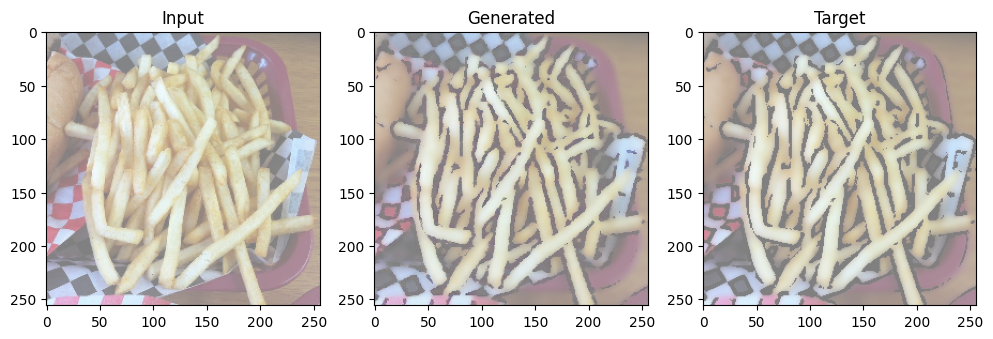

Epoch 2/50
Step 100: Generator Loss: 4.6417, Discriminator Loss: 0.7655
Step 200: Generator Loss: 4.0083, Discriminator Loss: 0.8490
Step 300: Generator Loss: 2.8281, Discriminator Loss: 1.0755
Step 400: Generator Loss: 3.3237, Discriminator Loss: 1.1842
Step 500: Generator Loss: 3.4171, Discriminator Loss: 0.8798
Step 600: Generator Loss: 5.0271, Discriminator Loss: 0.6753
Epoch 2 Completed: Avg Generator Loss: 4.1084, Avg Discriminator Loss: 0.9276


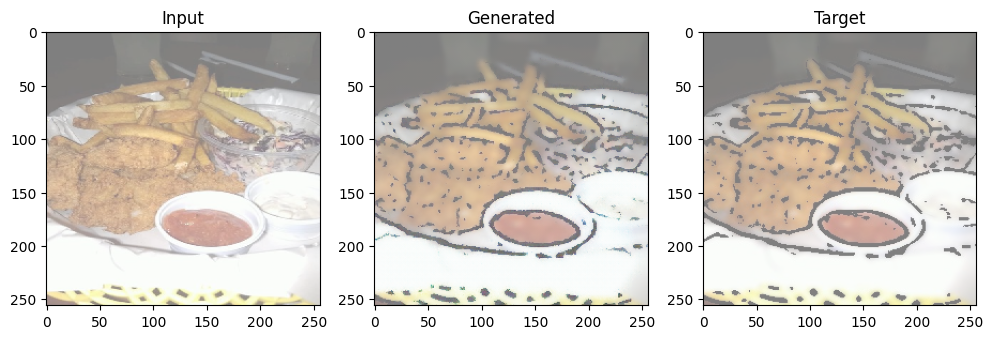

Epoch 3/50
Step 100: Generator Loss: 3.8192, Discriminator Loss: 0.8129
Step 200: Generator Loss: 4.7222, Discriminator Loss: 1.3168
Step 300: Generator Loss: 4.3062, Discriminator Loss: 0.7794
Step 400: Generator Loss: 7.0524, Discriminator Loss: 0.4831
Step 500: Generator Loss: 3.3219, Discriminator Loss: 0.9030
Step 600: Generator Loss: 4.8644, Discriminator Loss: 0.8234
Epoch 3 Completed: Avg Generator Loss: 4.0762, Avg Discriminator Loss: 0.9786


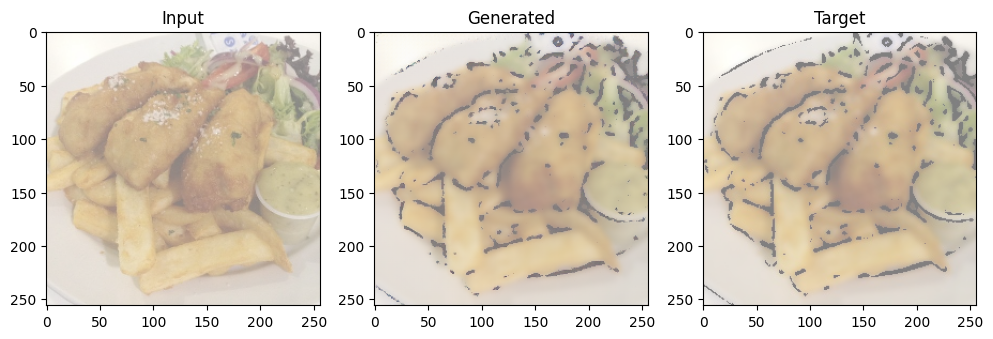

Epoch 4/50
Step 100: Generator Loss: 2.9372, Discriminator Loss: 1.2135
Step 200: Generator Loss: 3.6141, Discriminator Loss: 0.9232
Step 300: Generator Loss: 4.8973, Discriminator Loss: 0.7119
Step 400: Generator Loss: 3.7522, Discriminator Loss: 0.9940
Step 500: Generator Loss: 2.9548, Discriminator Loss: 1.0712
Step 600: Generator Loss: 4.1791, Discriminator Loss: 1.4180
Epoch 4 Completed: Avg Generator Loss: 4.0884, Avg Discriminator Loss: 0.9237


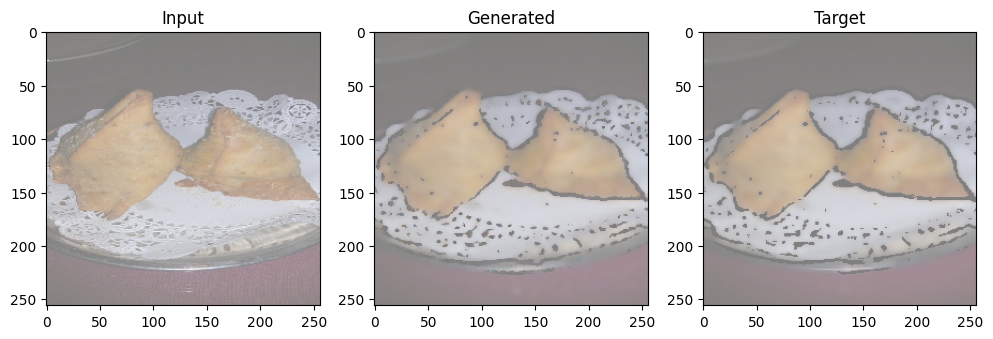

Epoch 5/50
Step 100: Generator Loss: 4.5104, Discriminator Loss: 0.6715
Step 200: Generator Loss: 5.8134, Discriminator Loss: 0.5442
Step 300: Generator Loss: 3.5978, Discriminator Loss: 1.0277
Step 400: Generator Loss: 3.4771, Discriminator Loss: 1.1616
Step 500: Generator Loss: 2.8479, Discriminator Loss: 0.9967
Step 600: Generator Loss: 6.2375, Discriminator Loss: 0.3793
Epoch 5 Completed: Avg Generator Loss: 4.0800, Avg Discriminator Loss: 0.9174


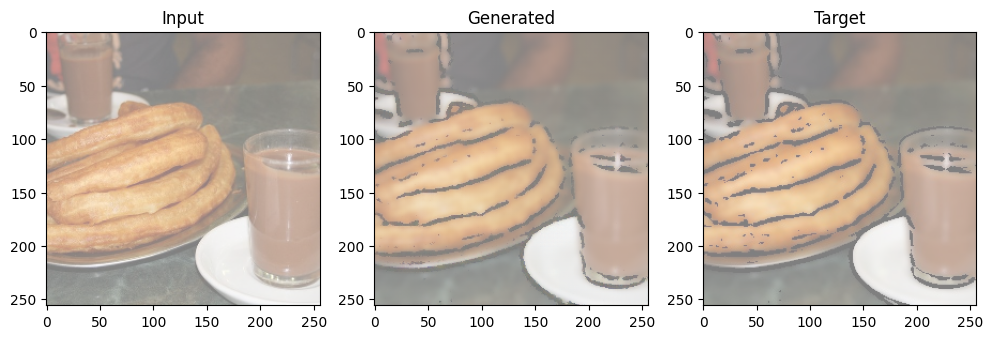

Epoch 6/50
Step 100: Generator Loss: 3.5190, Discriminator Loss: 0.8672
Step 200: Generator Loss: 3.5103, Discriminator Loss: 0.9170
Step 300: Generator Loss: 5.1585, Discriminator Loss: 0.5661
Step 400: Generator Loss: 3.9758, Discriminator Loss: 0.8550
Step 500: Generator Loss: 3.6137, Discriminator Loss: 0.8396
Step 600: Generator Loss: 3.4422, Discriminator Loss: 0.9808
Epoch 6 Completed: Avg Generator Loss: 4.0958, Avg Discriminator Loss: 1.0257


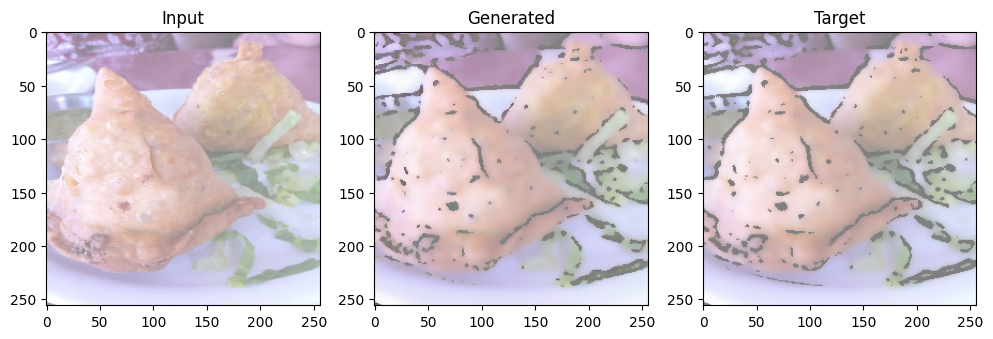

Epoch 7/50
Step 100: Generator Loss: 4.0870, Discriminator Loss: 0.7863
Step 200: Generator Loss: 5.4101, Discriminator Loss: 0.5161
Step 300: Generator Loss: 3.2826, Discriminator Loss: 1.1939
Step 400: Generator Loss: 2.0586, Discriminator Loss: 1.1046
Step 500: Generator Loss: 4.9513, Discriminator Loss: 0.8034
Step 600: Generator Loss: 4.4777, Discriminator Loss: 0.6175
Epoch 7 Completed: Avg Generator Loss: 4.0439, Avg Discriminator Loss: 0.8809


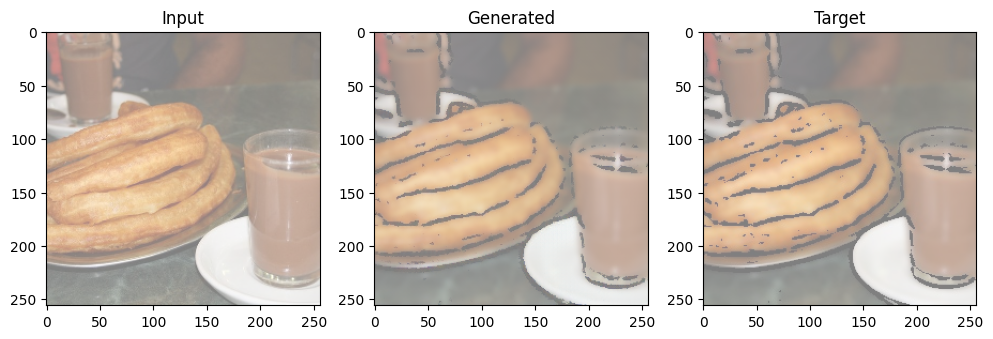

Epoch 8/50
Step 100: Generator Loss: 2.3664, Discriminator Loss: 1.6726
Step 200: Generator Loss: 4.6744, Discriminator Loss: 0.5196
Step 300: Generator Loss: 4.6677, Discriminator Loss: 0.8315
Step 400: Generator Loss: 4.5960, Discriminator Loss: 0.5832
Step 500: Generator Loss: 4.1099, Discriminator Loss: 0.7771
Step 600: Generator Loss: 2.7181, Discriminator Loss: 1.6621
Epoch 8 Completed: Avg Generator Loss: 4.0685, Avg Discriminator Loss: 0.9551


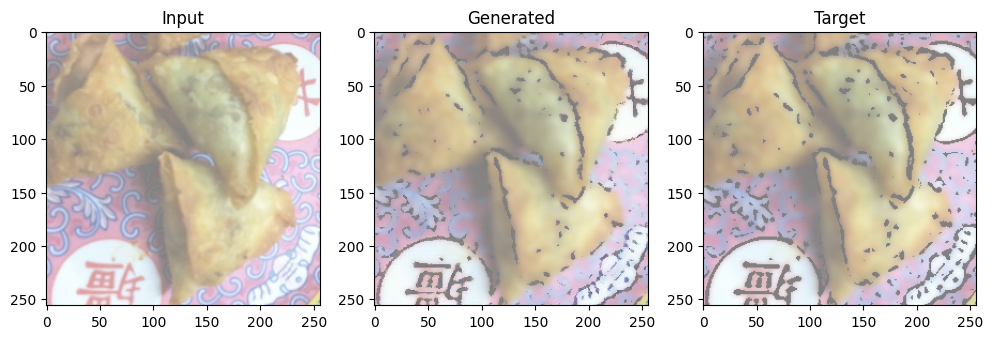

Epoch 9/50
Step 100: Generator Loss: 3.6127, Discriminator Loss: 0.9323
Step 200: Generator Loss: 3.9660, Discriminator Loss: 0.7868
Step 300: Generator Loss: 3.8974, Discriminator Loss: 0.6933
Step 400: Generator Loss: 3.7608, Discriminator Loss: 0.8957
Step 500: Generator Loss: 3.7872, Discriminator Loss: 0.8054
Step 600: Generator Loss: 3.8743, Discriminator Loss: 0.8202
Epoch 9 Completed: Avg Generator Loss: 4.0169, Avg Discriminator Loss: 0.8997


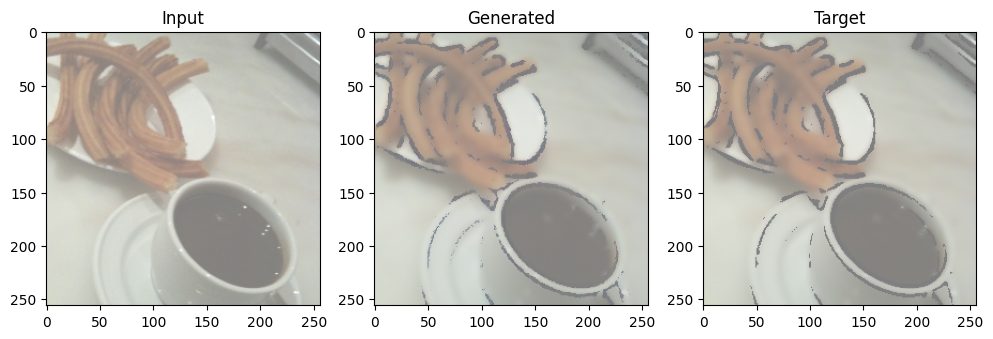

Epoch 10/50
Step 100: Generator Loss: 3.6970, Discriminator Loss: 0.8581
Step 200: Generator Loss: 3.4902, Discriminator Loss: 0.9939
Step 300: Generator Loss: 4.8385, Discriminator Loss: 2.5609
Step 400: Generator Loss: 3.4273, Discriminator Loss: 0.9538
Step 500: Generator Loss: 3.7555, Discriminator Loss: 0.9469
Step 600: Generator Loss: 3.0545, Discriminator Loss: 1.0794
Epoch 10 Completed: Avg Generator Loss: 4.0992, Avg Discriminator Loss: 1.0242


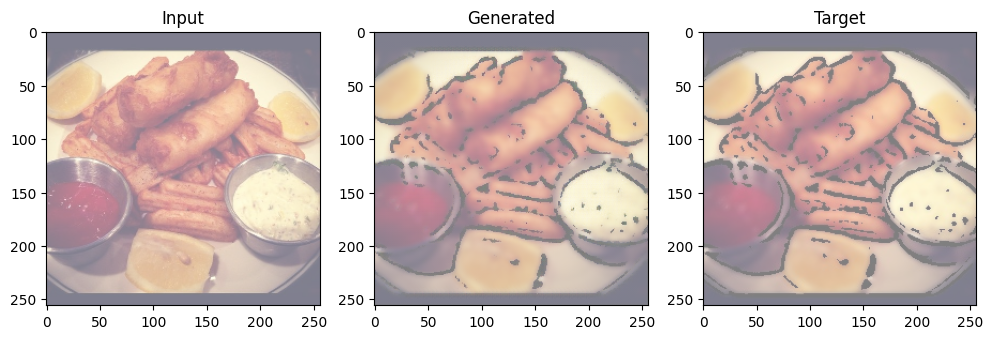

Epoch 11/50
Step 100: Generator Loss: 4.1323, Discriminator Loss: 0.8972
Step 200: Generator Loss: 3.6477, Discriminator Loss: 0.8353
Step 300: Generator Loss: 3.6098, Discriminator Loss: 0.8595
Step 400: Generator Loss: 3.3475, Discriminator Loss: 0.9673
Step 500: Generator Loss: 3.7783, Discriminator Loss: 0.7913
Step 600: Generator Loss: 4.1837, Discriminator Loss: 0.9184
Epoch 11 Completed: Avg Generator Loss: 4.0471, Avg Discriminator Loss: 0.8670


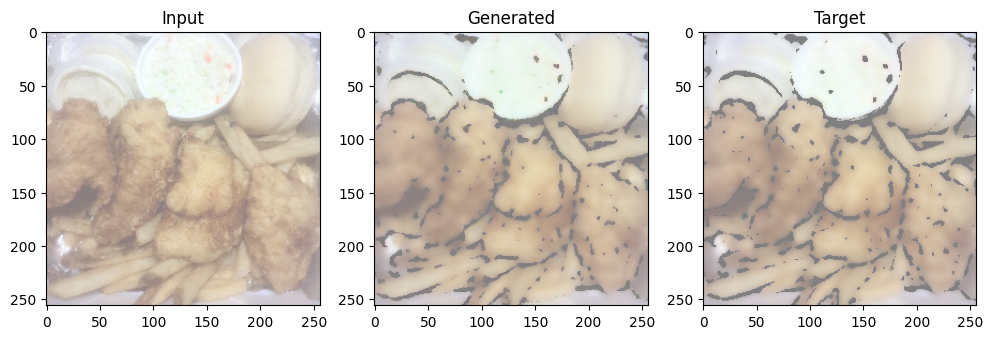

Epoch 12/50
Step 100: Generator Loss: 4.5772, Discriminator Loss: 0.6577
Step 200: Generator Loss: 3.1822, Discriminator Loss: 1.0842
Step 300: Generator Loss: 3.2859, Discriminator Loss: 1.0821
Step 400: Generator Loss: 4.4477, Discriminator Loss: 0.7158
Step 500: Generator Loss: 3.4118, Discriminator Loss: 2.0440
Step 600: Generator Loss: 4.2658, Discriminator Loss: 0.7398
Epoch 12 Completed: Avg Generator Loss: 4.0119, Avg Discriminator Loss: 0.9653


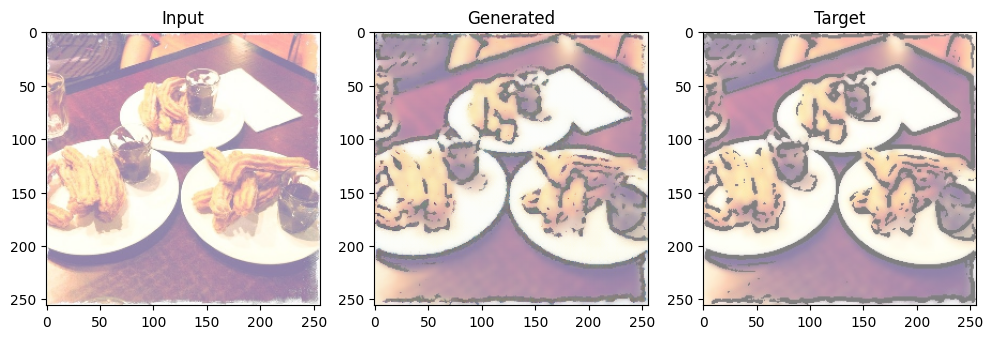

Epoch 13/50
Step 100: Generator Loss: 4.2824, Discriminator Loss: 0.7288
Step 200: Generator Loss: 5.0399, Discriminator Loss: 0.6269
Step 300: Generator Loss: 4.0234, Discriminator Loss: 0.7714
Step 400: Generator Loss: 5.0439, Discriminator Loss: 0.9416
Step 500: Generator Loss: 3.5023, Discriminator Loss: 0.7917
Step 600: Generator Loss: 3.7231, Discriminator Loss: 0.7279
Epoch 13 Completed: Avg Generator Loss: 4.0130, Avg Discriminator Loss: 0.9311


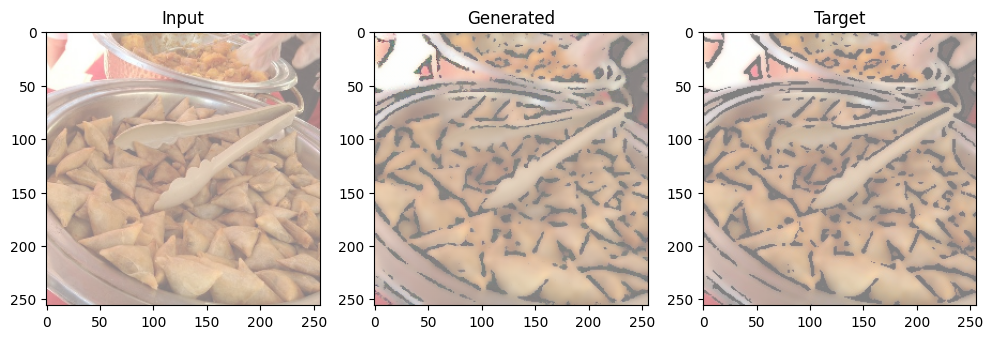

Epoch 14/50
Step 100: Generator Loss: 3.2346, Discriminator Loss: 1.0134
Step 200: Generator Loss: 3.4796, Discriminator Loss: 0.9869
Step 300: Generator Loss: 3.9440, Discriminator Loss: 0.7956
Step 400: Generator Loss: 4.6160, Discriminator Loss: 0.6309
Step 500: Generator Loss: 4.3872, Discriminator Loss: 0.8308
Step 600: Generator Loss: 4.0305, Discriminator Loss: 0.9274
Epoch 14 Completed: Avg Generator Loss: 4.0380, Avg Discriminator Loss: 0.9221


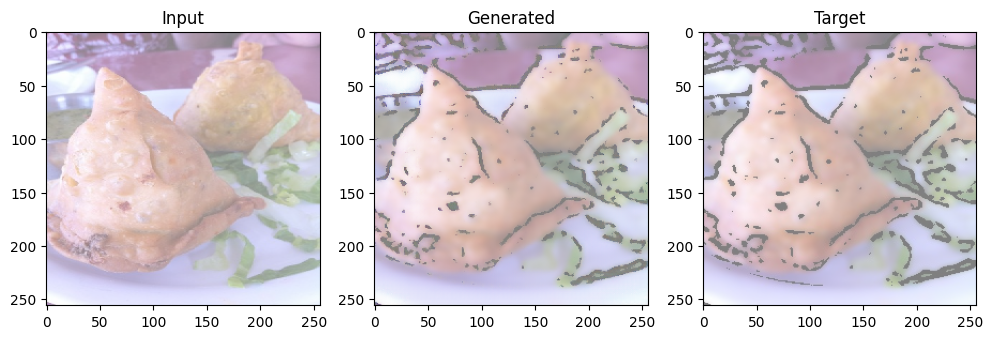

Epoch 15/50
Step 100: Generator Loss: 3.6461, Discriminator Loss: 0.8510
Step 200: Generator Loss: 4.2445, Discriminator Loss: 0.8518
Step 300: Generator Loss: 3.6443, Discriminator Loss: 1.2536
Step 400: Generator Loss: 4.1239, Discriminator Loss: 0.7361
Step 500: Generator Loss: 3.8974, Discriminator Loss: 0.7568
Step 600: Generator Loss: 4.1141, Discriminator Loss: 1.3860
Epoch 15 Completed: Avg Generator Loss: 3.9845, Avg Discriminator Loss: 1.0030


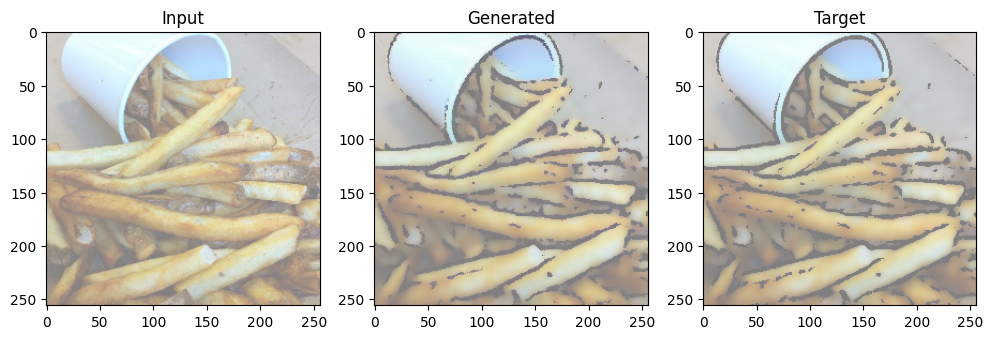

Epoch 16/50
Step 100: Generator Loss: 5.6727, Discriminator Loss: 0.4572
Step 200: Generator Loss: 3.0501, Discriminator Loss: 1.1575
Step 300: Generator Loss: 5.1053, Discriminator Loss: 0.7983
Step 400: Generator Loss: 4.6754, Discriminator Loss: 0.7246
Step 500: Generator Loss: 2.9076, Discriminator Loss: 1.2961
Step 600: Generator Loss: 4.2929, Discriminator Loss: 0.8599
Epoch 16 Completed: Avg Generator Loss: 3.9618, Avg Discriminator Loss: 0.9215


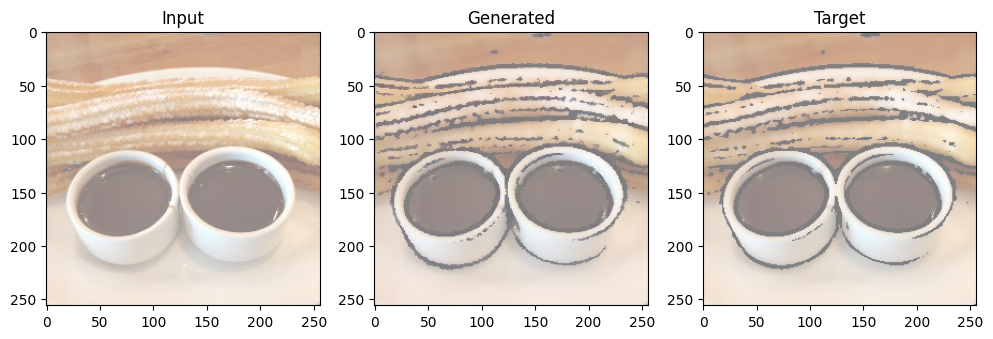

Epoch 17/50
Step 100: Generator Loss: 6.4345, Discriminator Loss: 0.5566
Step 200: Generator Loss: 5.1494, Discriminator Loss: 0.7637
Step 300: Generator Loss: 3.6993, Discriminator Loss: 0.9382
Step 400: Generator Loss: 3.2948, Discriminator Loss: 1.0375
Step 500: Generator Loss: 3.6046, Discriminator Loss: 0.7667
Step 600: Generator Loss: 2.7425, Discriminator Loss: 1.0235
Epoch 17 Completed: Avg Generator Loss: 4.0309, Avg Discriminator Loss: 0.9046


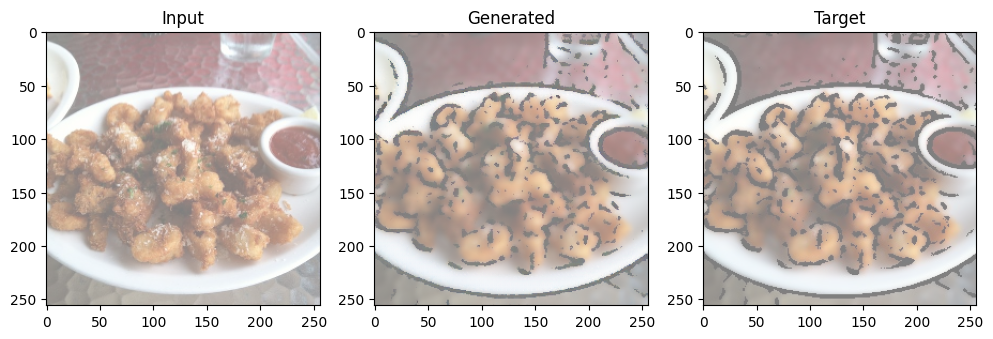

Epoch 18/50
Step 100: Generator Loss: 3.6830, Discriminator Loss: 1.1936
Step 200: Generator Loss: 3.1874, Discriminator Loss: 1.2046
Step 300: Generator Loss: 4.1987, Discriminator Loss: 0.6706
Step 400: Generator Loss: 6.0040, Discriminator Loss: 0.7304
Step 500: Generator Loss: 3.5706, Discriminator Loss: 0.8962
Step 600: Generator Loss: 5.0063, Discriminator Loss: 0.6546
Epoch 18 Completed: Avg Generator Loss: 4.0255, Avg Discriminator Loss: 0.9920


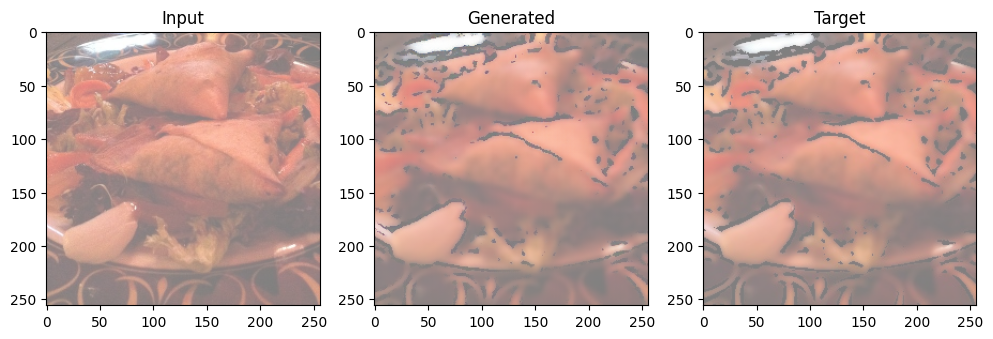

Epoch 19/50
Step 100: Generator Loss: 4.6065, Discriminator Loss: 0.6412
Step 200: Generator Loss: 3.6207, Discriminator Loss: 0.8653
Step 300: Generator Loss: 2.6480, Discriminator Loss: 1.1967
Step 400: Generator Loss: 4.0700, Discriminator Loss: 0.8207
Step 500: Generator Loss: 3.0598, Discriminator Loss: 0.9411
Step 600: Generator Loss: 2.8515, Discriminator Loss: 1.1952
Epoch 19 Completed: Avg Generator Loss: 3.9734, Avg Discriminator Loss: 0.9391


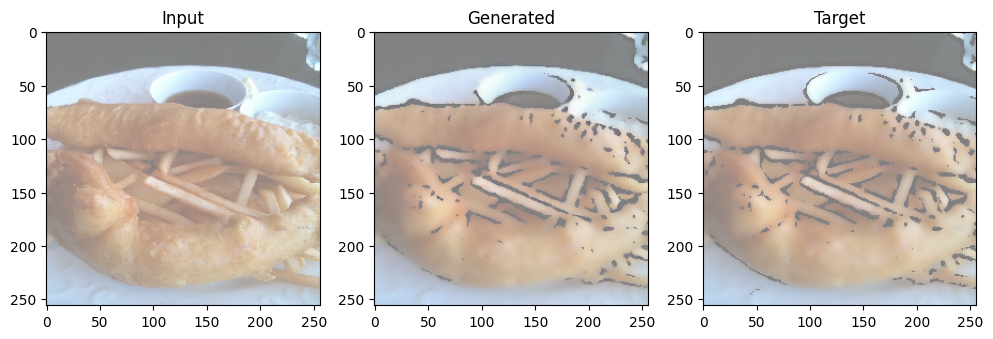

Epoch 20/50
Step 100: Generator Loss: 4.7354, Discriminator Loss: 0.9853
Step 200: Generator Loss: 2.6384, Discriminator Loss: 1.2009
Step 300: Generator Loss: 3.0614, Discriminator Loss: 1.0650
Step 400: Generator Loss: 4.3702, Discriminator Loss: 0.6438
Step 500: Generator Loss: 6.1942, Discriminator Loss: 0.5227
Step 600: Generator Loss: 5.0149, Discriminator Loss: 0.5867
Epoch 20 Completed: Avg Generator Loss: 4.0635, Avg Discriminator Loss: 1.1193


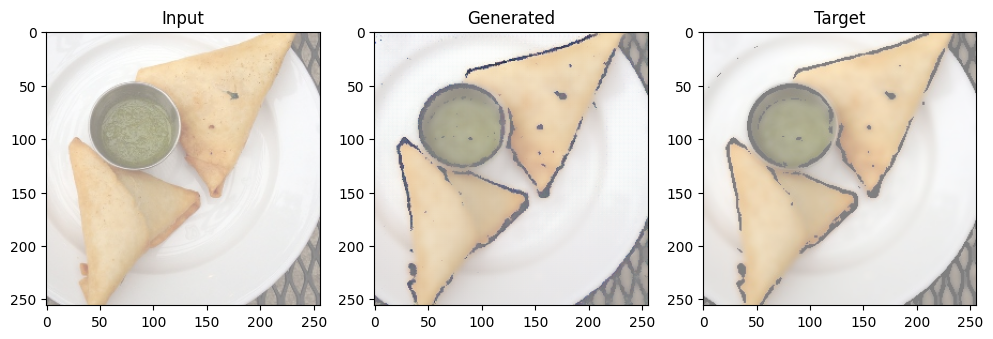

Epoch 21/50
Step 100: Generator Loss: 3.4861, Discriminator Loss: 0.9539
Step 200: Generator Loss: 2.1496, Discriminator Loss: 1.2571
Step 300: Generator Loss: 3.3920, Discriminator Loss: 0.8237
Step 400: Generator Loss: 5.5953, Discriminator Loss: 0.6079
Step 500: Generator Loss: 4.7466, Discriminator Loss: 0.6184
Step 600: Generator Loss: 3.4384, Discriminator Loss: 1.0307
Epoch 21 Completed: Avg Generator Loss: 4.0136, Avg Discriminator Loss: 1.0621


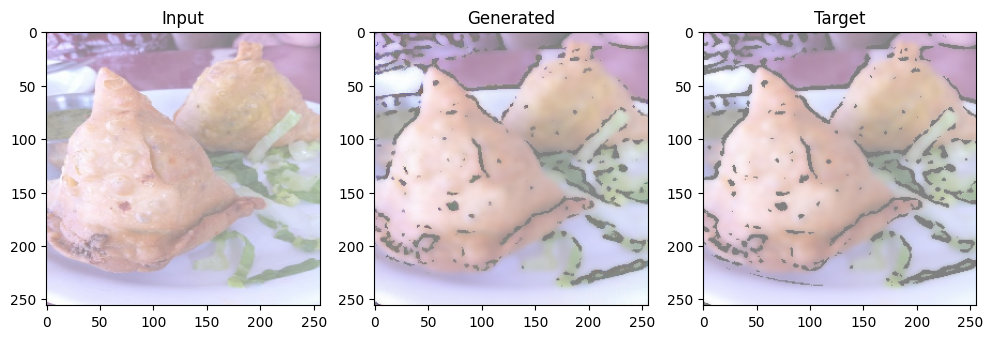

Epoch 22/50
Step 100: Generator Loss: 4.8315, Discriminator Loss: 0.5960
Step 200: Generator Loss: 2.6289, Discriminator Loss: 1.1542
Step 300: Generator Loss: 5.7099, Discriminator Loss: 0.4657
Step 400: Generator Loss: 3.9674, Discriminator Loss: 0.8382
Step 500: Generator Loss: 4.3262, Discriminator Loss: 0.7313
Step 600: Generator Loss: 3.2467, Discriminator Loss: 1.0111
Epoch 22 Completed: Avg Generator Loss: 3.9773, Avg Discriminator Loss: 0.9291


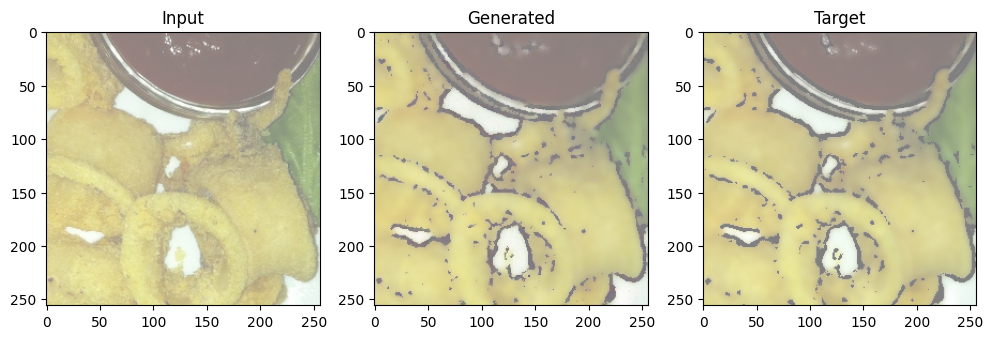

Epoch 23/50
Step 100: Generator Loss: 3.3882, Discriminator Loss: 0.8059
Step 200: Generator Loss: 3.4351, Discriminator Loss: 0.8935
Step 300: Generator Loss: 2.1451, Discriminator Loss: 1.1896
Step 400: Generator Loss: 3.7463, Discriminator Loss: 0.8186
Step 500: Generator Loss: 3.6181, Discriminator Loss: 0.9670
Step 600: Generator Loss: 3.4487, Discriminator Loss: 0.9003
Epoch 23 Completed: Avg Generator Loss: 3.9512, Avg Discriminator Loss: 0.9286


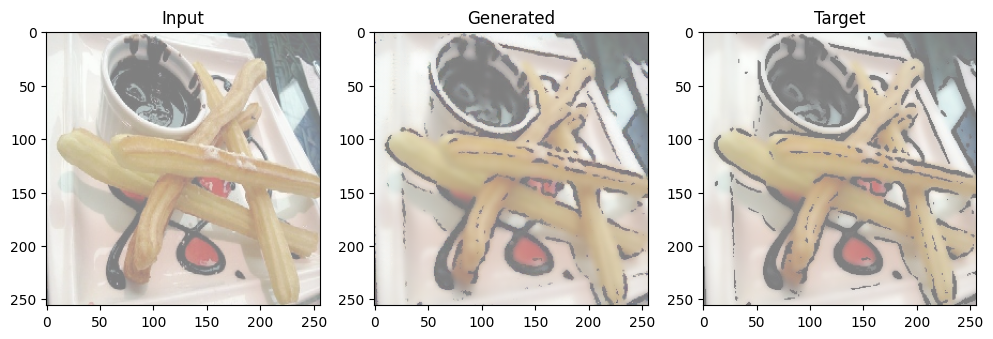

Epoch 24/50
Step 100: Generator Loss: 2.8721, Discriminator Loss: 2.0827
Step 200: Generator Loss: 5.4758, Discriminator Loss: 0.5740
Step 300: Generator Loss: 5.0532, Discriminator Loss: 0.6591
Step 400: Generator Loss: 4.3932, Discriminator Loss: 0.7266
Step 500: Generator Loss: 4.8635, Discriminator Loss: 1.2226
Step 600: Generator Loss: 5.2434, Discriminator Loss: 0.8411
Epoch 24 Completed: Avg Generator Loss: 3.9449, Avg Discriminator Loss: 0.9856


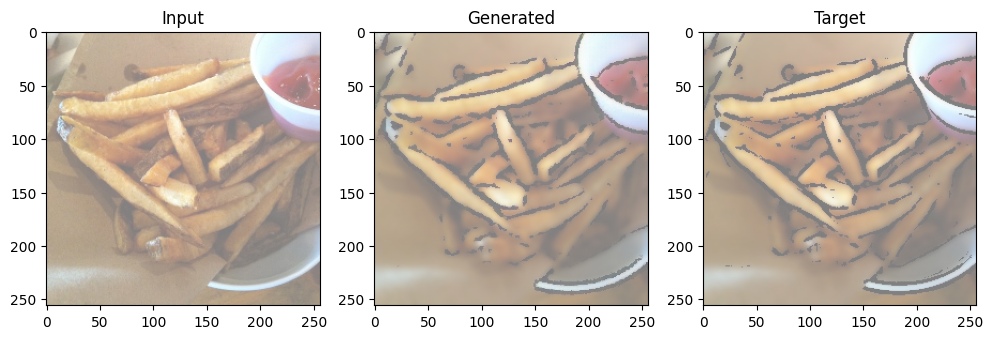

Epoch 25/50
Step 100: Generator Loss: 4.2775, Discriminator Loss: 0.8205
Step 200: Generator Loss: 3.7503, Discriminator Loss: 0.9700
Step 300: Generator Loss: 3.7687, Discriminator Loss: 1.0787
Step 400: Generator Loss: 3.8383, Discriminator Loss: 0.7468
Step 500: Generator Loss: 4.0536, Discriminator Loss: 0.8422
Step 600: Generator Loss: 3.3738, Discriminator Loss: 0.8655
Epoch 25 Completed: Avg Generator Loss: 3.9659, Avg Discriminator Loss: 1.0085


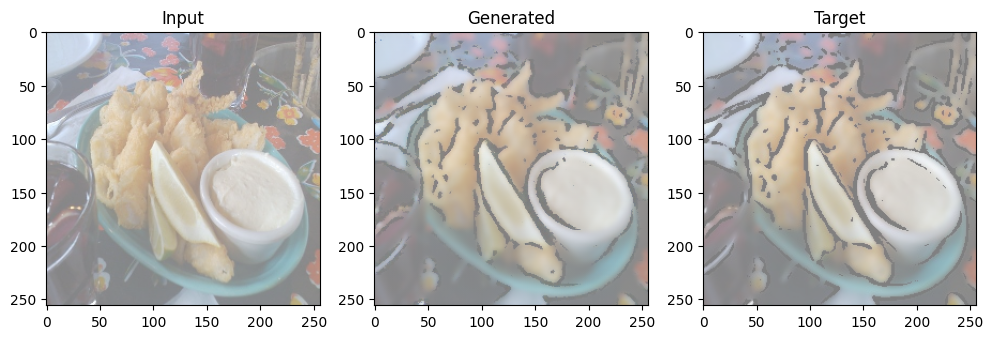

Epoch 26/50
Step 100: Generator Loss: 4.8459, Discriminator Loss: 0.8683
Step 200: Generator Loss: 3.1292, Discriminator Loss: 1.1030
Step 300: Generator Loss: 3.4254, Discriminator Loss: 1.3692
Step 400: Generator Loss: 3.5695, Discriminator Loss: 0.8585
Step 500: Generator Loss: 4.4544, Discriminator Loss: 0.7375
Step 600: Generator Loss: 5.6795, Discriminator Loss: 0.6529
Epoch 26 Completed: Avg Generator Loss: 4.0049, Avg Discriminator Loss: 1.0029


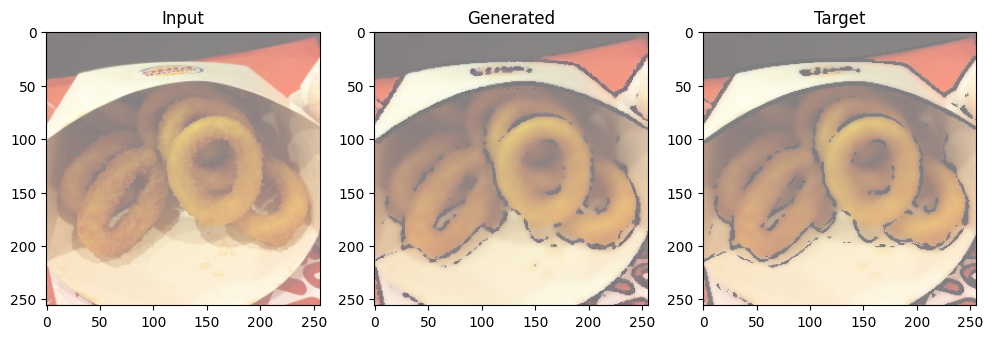

Epoch 27/50
Step 100: Generator Loss: 4.6175, Discriminator Loss: 0.7316
Step 200: Generator Loss: 3.3249, Discriminator Loss: 0.9903
Step 300: Generator Loss: 3.7724, Discriminator Loss: 0.8649
Step 400: Generator Loss: 4.2885, Discriminator Loss: 0.8059
Step 500: Generator Loss: 2.8114, Discriminator Loss: 1.0269
Step 600: Generator Loss: 4.7631, Discriminator Loss: 0.8198
Epoch 27 Completed: Avg Generator Loss: 3.9154, Avg Discriminator Loss: 0.9115


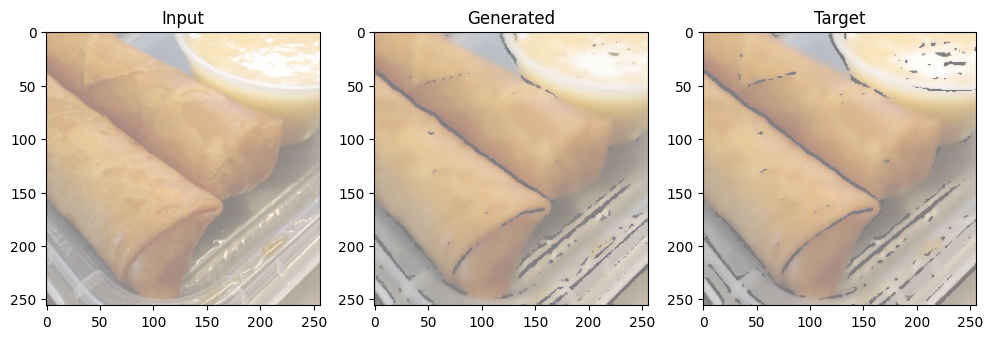

Epoch 28/50
Step 100: Generator Loss: 3.7682, Discriminator Loss: 0.8890
Step 200: Generator Loss: 4.2855, Discriminator Loss: 0.7583
Step 300: Generator Loss: 3.5207, Discriminator Loss: 1.0140
Step 400: Generator Loss: 3.1963, Discriminator Loss: 0.9456
Step 500: Generator Loss: 3.5118, Discriminator Loss: 0.8674
Step 600: Generator Loss: 3.4667, Discriminator Loss: 1.2117
Epoch 28 Completed: Avg Generator Loss: 3.9609, Avg Discriminator Loss: 0.9636


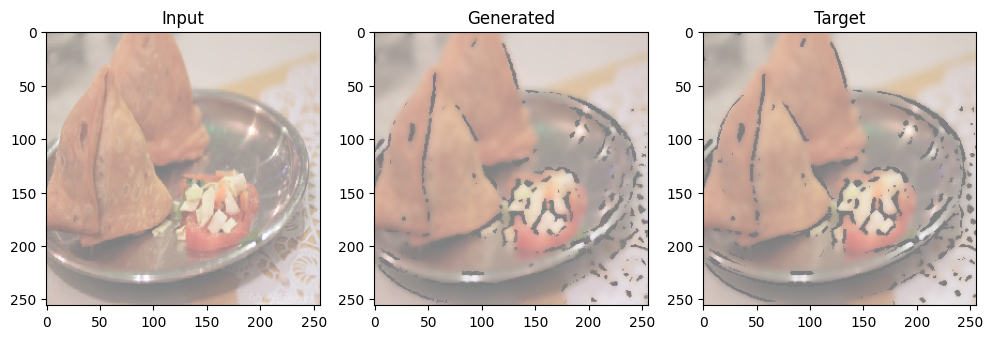

Epoch 29/50
Step 100: Generator Loss: 3.6269, Discriminator Loss: 0.9308
Step 200: Generator Loss: 4.9265, Discriminator Loss: 0.5311
Step 300: Generator Loss: 4.6681, Discriminator Loss: 0.6904
Step 400: Generator Loss: 3.0950, Discriminator Loss: 1.0507
Step 500: Generator Loss: 3.1863, Discriminator Loss: 1.0119
Step 600: Generator Loss: 3.8191, Discriminator Loss: 0.9642
Epoch 29 Completed: Avg Generator Loss: 3.9586, Avg Discriminator Loss: 1.0672


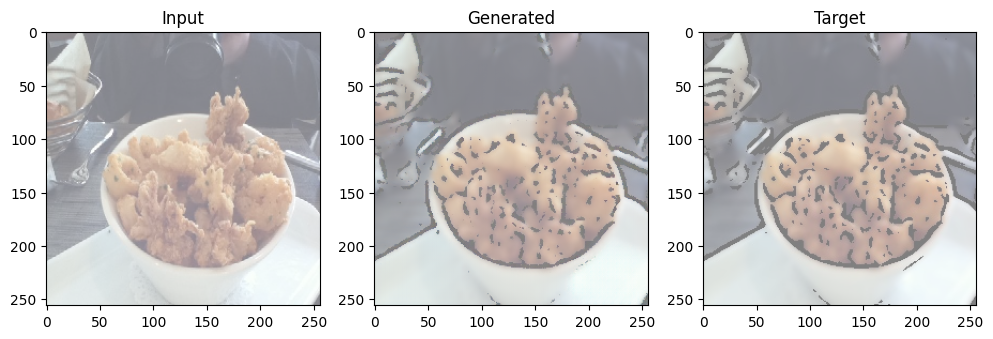

Epoch 30/50
Step 100: Generator Loss: 4.9000, Discriminator Loss: 0.8685
Step 200: Generator Loss: 4.1142, Discriminator Loss: 0.8351
Step 300: Generator Loss: 5.0026, Discriminator Loss: 0.6326
Step 400: Generator Loss: 4.9878, Discriminator Loss: 0.6823
Step 500: Generator Loss: 5.1151, Discriminator Loss: 0.8686
Step 600: Generator Loss: 3.4237, Discriminator Loss: 0.9252
Epoch 30 Completed: Avg Generator Loss: 3.9260, Avg Discriminator Loss: 0.9134


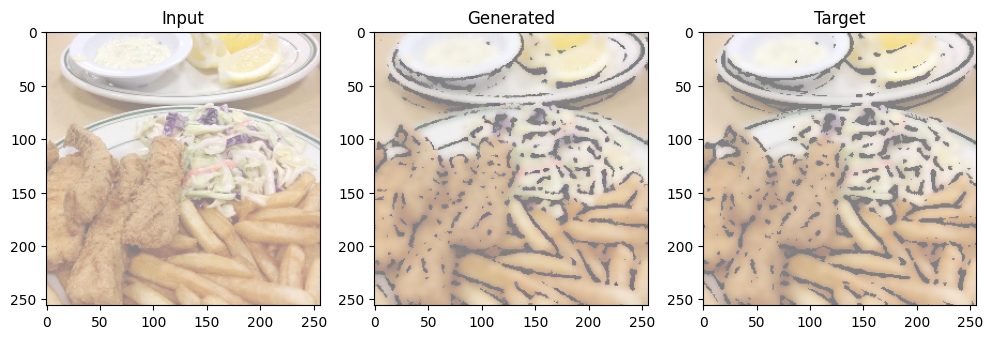

Epoch 31/50
Step 100: Generator Loss: 4.6220, Discriminator Loss: 0.7127
Step 200: Generator Loss: 3.4756, Discriminator Loss: 0.8755
Step 300: Generator Loss: 3.1071, Discriminator Loss: 2.1440
Step 400: Generator Loss: 3.3565, Discriminator Loss: 0.9432
Step 500: Generator Loss: 3.6773, Discriminator Loss: 1.0192
Step 600: Generator Loss: 3.2786, Discriminator Loss: 0.9940
Epoch 31 Completed: Avg Generator Loss: 3.9504, Avg Discriminator Loss: 0.9558


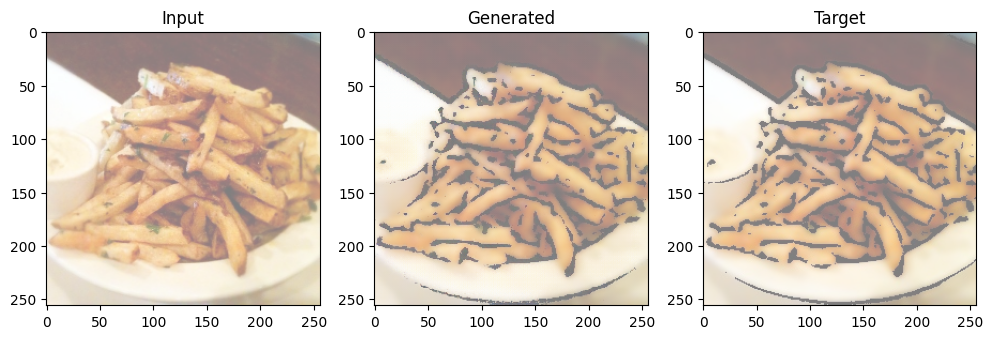

Epoch 32/50
Step 100: Generator Loss: 3.5088, Discriminator Loss: 1.1754
Step 200: Generator Loss: 4.2032, Discriminator Loss: 0.7964
Step 300: Generator Loss: 3.9056, Discriminator Loss: 1.0300
Step 400: Generator Loss: 4.7633, Discriminator Loss: 0.6254
Step 500: Generator Loss: 3.9921, Discriminator Loss: 0.8749
Step 600: Generator Loss: 3.0181, Discriminator Loss: 1.4080
Epoch 32 Completed: Avg Generator Loss: 3.8931, Avg Discriminator Loss: 0.9867


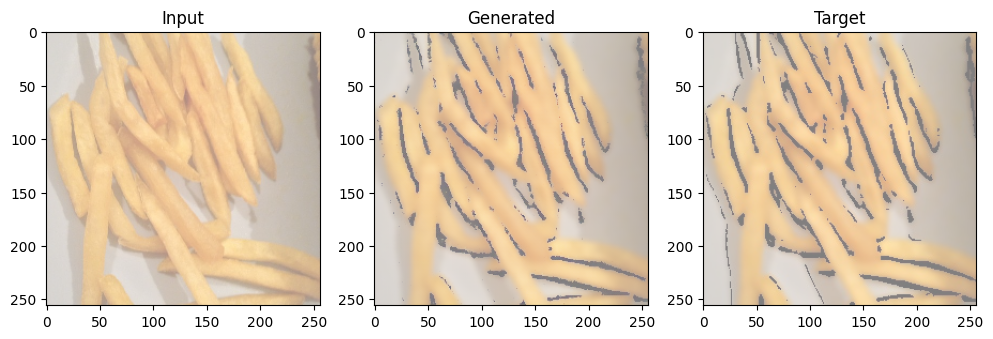

Epoch 33/50
Step 100: Generator Loss: 2.8003, Discriminator Loss: 1.0278
Step 200: Generator Loss: 3.1624, Discriminator Loss: 0.8006
Step 300: Generator Loss: 3.1432, Discriminator Loss: 0.9936
Step 400: Generator Loss: 5.4318, Discriminator Loss: 0.4386
Step 500: Generator Loss: 4.2163, Discriminator Loss: 0.8316
Step 600: Generator Loss: 3.8457, Discriminator Loss: 0.8761
Epoch 33 Completed: Avg Generator Loss: 3.9240, Avg Discriminator Loss: 0.9522


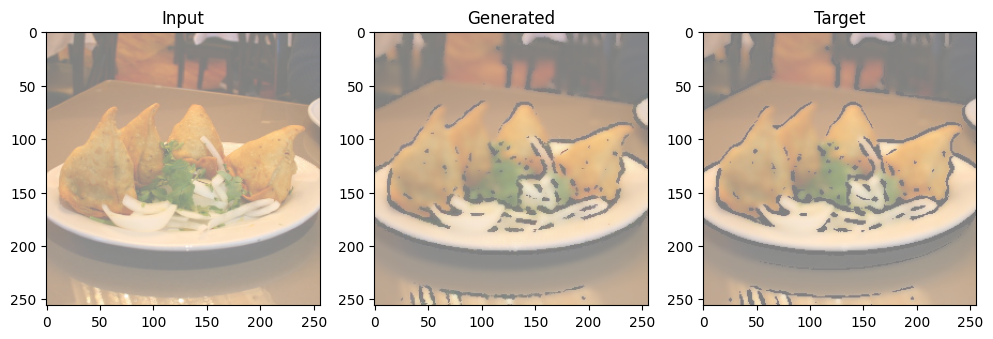

Epoch 34/50
Step 100: Generator Loss: 3.3431, Discriminator Loss: 1.0380
Step 200: Generator Loss: 2.2866, Discriminator Loss: 1.2123
Step 300: Generator Loss: 2.4299, Discriminator Loss: 1.2637
Step 400: Generator Loss: 4.9914, Discriminator Loss: 0.5620
Step 500: Generator Loss: 4.9354, Discriminator Loss: 0.5268
Step 600: Generator Loss: 3.7767, Discriminator Loss: 0.9775
Epoch 34 Completed: Avg Generator Loss: 3.9500, Avg Discriminator Loss: 1.0493


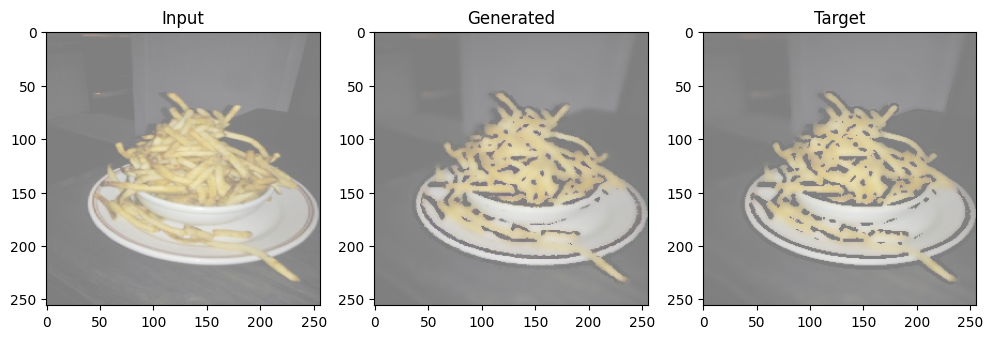

Epoch 35/50
Step 100: Generator Loss: 4.7869, Discriminator Loss: 0.8078
Step 200: Generator Loss: 3.9493, Discriminator Loss: 0.8481
Step 300: Generator Loss: 4.9619, Discriminator Loss: 0.6773
Step 400: Generator Loss: 4.7220, Discriminator Loss: 0.7724
Step 500: Generator Loss: 3.3569, Discriminator Loss: 0.9429
Step 600: Generator Loss: 2.5037, Discriminator Loss: 1.1570
Epoch 35 Completed: Avg Generator Loss: 3.9444, Avg Discriminator Loss: 0.9171


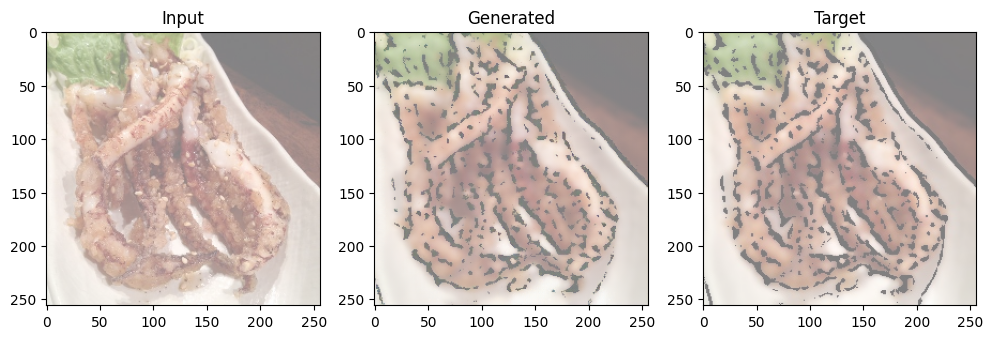

Epoch 36/50
Step 100: Generator Loss: 2.8173, Discriminator Loss: 2.3103
Step 200: Generator Loss: 3.9173, Discriminator Loss: 0.7602
Step 300: Generator Loss: 3.6536, Discriminator Loss: 1.0394
Step 400: Generator Loss: 3.0861, Discriminator Loss: 0.9640
Step 500: Generator Loss: 5.1468, Discriminator Loss: 0.8306
Step 600: Generator Loss: 5.2565, Discriminator Loss: 0.6162
Epoch 36 Completed: Avg Generator Loss: 3.9437, Avg Discriminator Loss: 0.9365


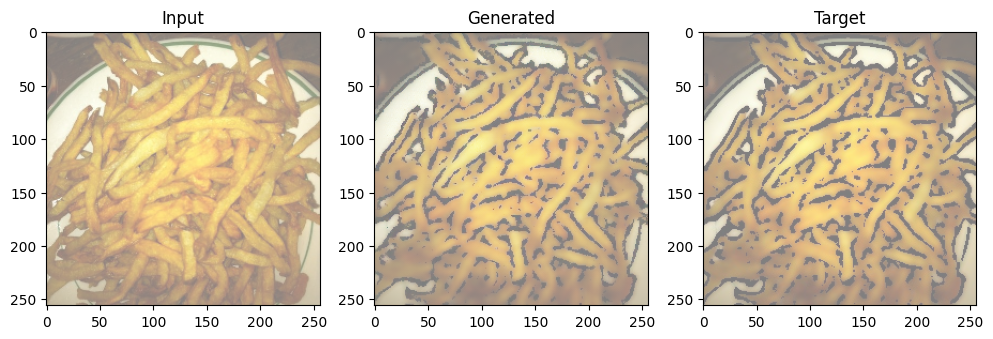

Epoch 37/50
Step 100: Generator Loss: 4.3172, Discriminator Loss: 0.7577
Step 200: Generator Loss: 5.6016, Discriminator Loss: 0.6385
Step 300: Generator Loss: 3.3614, Discriminator Loss: 0.9097
Step 400: Generator Loss: 3.9015, Discriminator Loss: 0.7911
Step 500: Generator Loss: 5.1876, Discriminator Loss: 0.5791
Step 600: Generator Loss: 4.9261, Discriminator Loss: 0.8199
Epoch 37 Completed: Avg Generator Loss: 3.9417, Avg Discriminator Loss: 1.0148


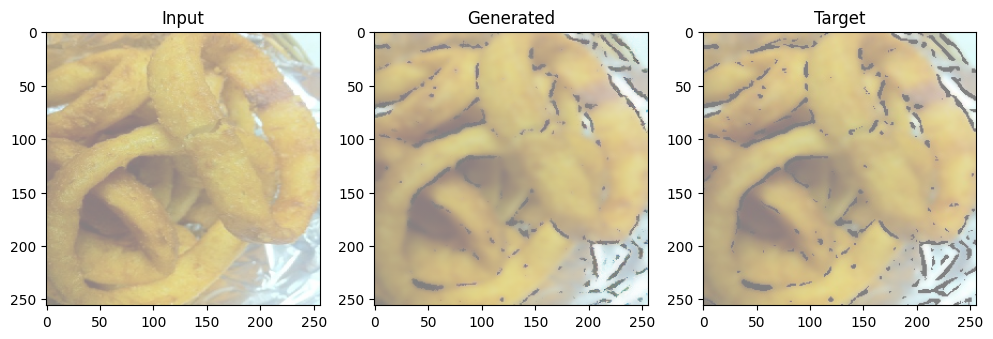

Epoch 38/50
Step 100: Generator Loss: 3.6596, Discriminator Loss: 0.9756
Step 200: Generator Loss: 2.9837, Discriminator Loss: 1.0321
Step 300: Generator Loss: 4.9603, Discriminator Loss: 0.4432
Step 400: Generator Loss: 3.6697, Discriminator Loss: 0.7929
Step 500: Generator Loss: 3.1035, Discriminator Loss: 0.9729
Step 600: Generator Loss: 3.2604, Discriminator Loss: 3.1543
Epoch 38 Completed: Avg Generator Loss: 3.8693, Avg Discriminator Loss: 0.9724


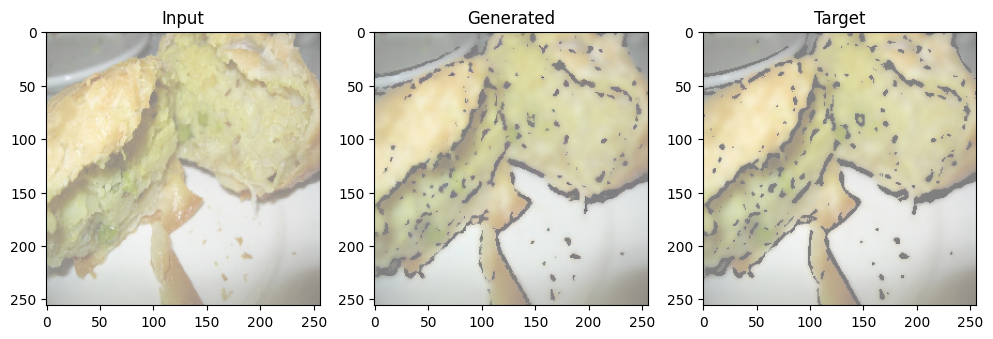

Epoch 39/50
Step 100: Generator Loss: 4.0816, Discriminator Loss: 0.7852
Step 200: Generator Loss: 3.4210, Discriminator Loss: 0.9157
Step 300: Generator Loss: 4.0404, Discriminator Loss: 0.8325
Step 400: Generator Loss: 4.2870, Discriminator Loss: 0.6548
Step 500: Generator Loss: 5.0882, Discriminator Loss: 0.7203
Step 600: Generator Loss: 3.3575, Discriminator Loss: 0.8455
Epoch 39 Completed: Avg Generator Loss: 3.9438, Avg Discriminator Loss: 1.0859


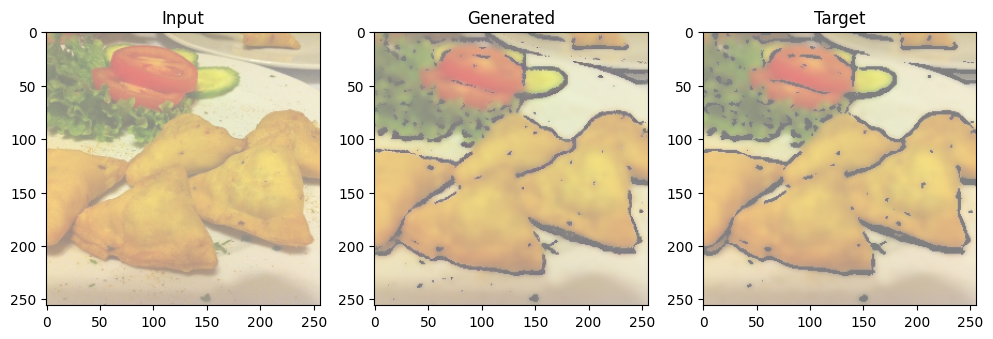

Epoch 40/50
Step 100: Generator Loss: 2.5050, Discriminator Loss: 1.1434
Step 200: Generator Loss: 3.3672, Discriminator Loss: 1.1516
Step 300: Generator Loss: 3.6135, Discriminator Loss: 0.8596
Step 400: Generator Loss: 3.0018, Discriminator Loss: 1.0629
Step 500: Generator Loss: 2.8858, Discriminator Loss: 1.0363
Step 600: Generator Loss: 2.4309, Discriminator Loss: 1.1085
Epoch 40 Completed: Avg Generator Loss: 3.9205, Avg Discriminator Loss: 0.9046


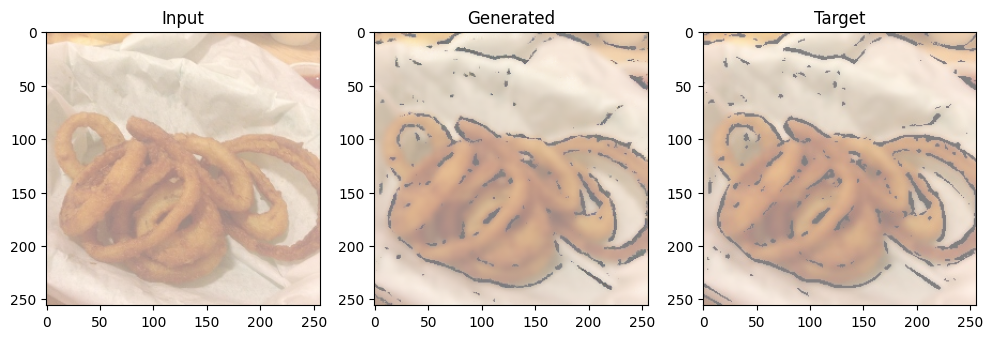

Epoch 41/50
Step 100: Generator Loss: 3.3055, Discriminator Loss: 0.8270
Step 200: Generator Loss: 3.9104, Discriminator Loss: 0.9916
Step 300: Generator Loss: 4.0348, Discriminator Loss: 0.6319
Step 400: Generator Loss: 4.1153, Discriminator Loss: 0.8025
Step 500: Generator Loss: 2.7009, Discriminator Loss: 1.0540
Step 600: Generator Loss: 3.4304, Discriminator Loss: 0.8800
Epoch 41 Completed: Avg Generator Loss: 3.8776, Avg Discriminator Loss: 0.9633


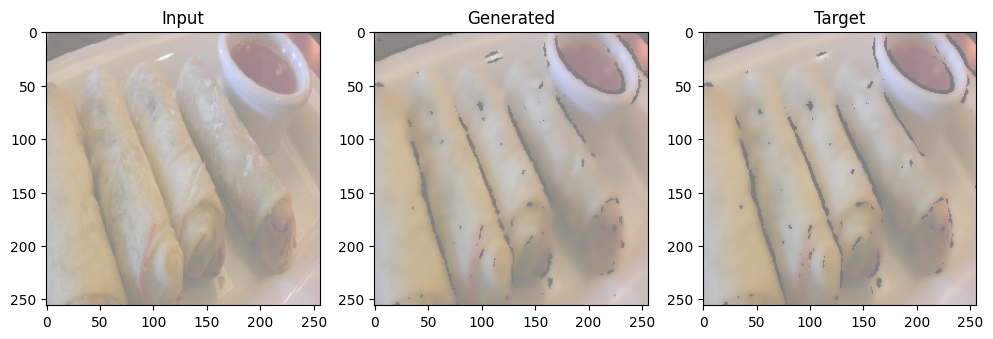

Epoch 42/50
Step 100: Generator Loss: 2.9822, Discriminator Loss: 1.0232
Step 200: Generator Loss: 5.6854, Discriminator Loss: 0.6218
Step 300: Generator Loss: 3.8275, Discriminator Loss: 2.6004
Step 400: Generator Loss: 3.3489, Discriminator Loss: 0.9825
Step 500: Generator Loss: 5.6274, Discriminator Loss: 0.6328
Step 600: Generator Loss: 4.7271, Discriminator Loss: 0.8064
Epoch 42 Completed: Avg Generator Loss: 3.9402, Avg Discriminator Loss: 0.9926


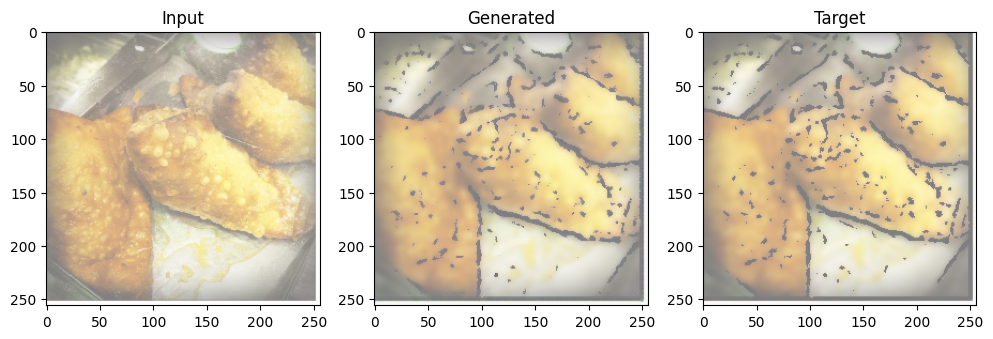

Epoch 43/50
Step 100: Generator Loss: 2.7883, Discriminator Loss: 1.1084
Step 200: Generator Loss: 5.1199, Discriminator Loss: 0.6662
Step 300: Generator Loss: 3.9852, Discriminator Loss: 0.7522
Step 400: Generator Loss: 3.5516, Discriminator Loss: 0.9179
Step 500: Generator Loss: 4.1931, Discriminator Loss: 0.6238
Step 600: Generator Loss: 3.2670, Discriminator Loss: 1.3496
Epoch 43 Completed: Avg Generator Loss: 3.9180, Avg Discriminator Loss: 0.9628


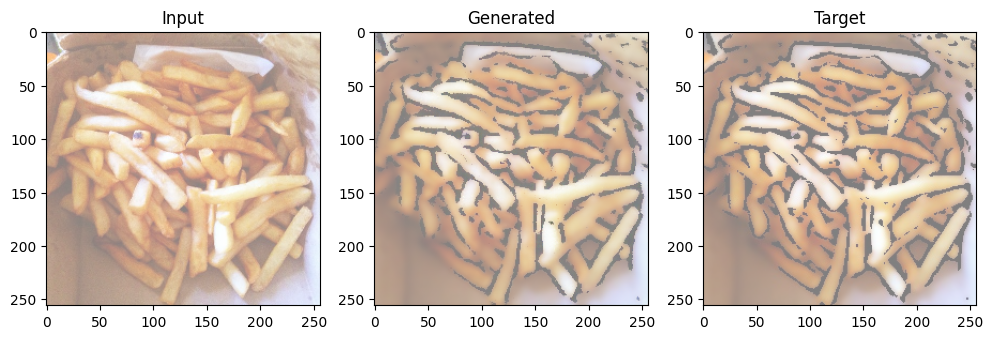

Epoch 44/50
Step 100: Generator Loss: 4.9010, Discriminator Loss: 2.0655
Step 200: Generator Loss: 5.3559, Discriminator Loss: 0.5245
Step 300: Generator Loss: 4.5809, Discriminator Loss: 0.6582
Step 400: Generator Loss: 4.1056, Discriminator Loss: 0.7688
Step 500: Generator Loss: 3.5034, Discriminator Loss: 0.9562
Step 600: Generator Loss: 5.5480, Discriminator Loss: 1.8637
Epoch 44 Completed: Avg Generator Loss: 3.9638, Avg Discriminator Loss: 1.0977


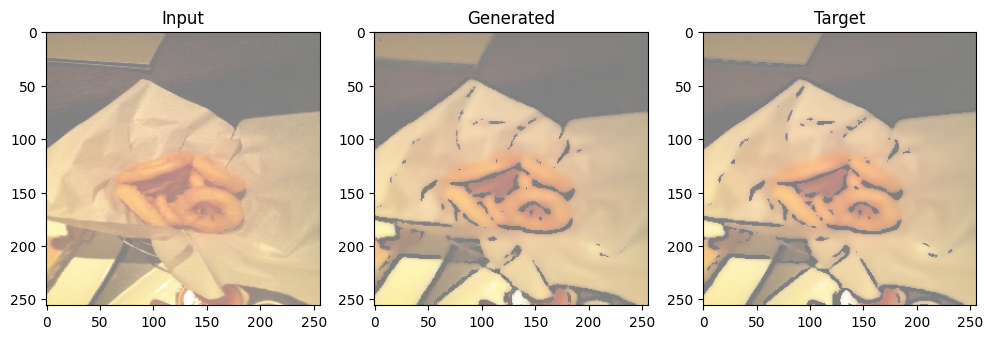

Epoch 45/50
Step 100: Generator Loss: 3.1446, Discriminator Loss: 1.1112
Step 200: Generator Loss: 4.8034, Discriminator Loss: 0.7245
Step 300: Generator Loss: 3.3362, Discriminator Loss: 1.1868
Step 400: Generator Loss: 4.1508, Discriminator Loss: 0.7855
Step 500: Generator Loss: 3.6222, Discriminator Loss: 0.7083
Step 600: Generator Loss: 3.6490, Discriminator Loss: 1.1751
Epoch 45 Completed: Avg Generator Loss: 3.9041, Avg Discriminator Loss: 0.9739


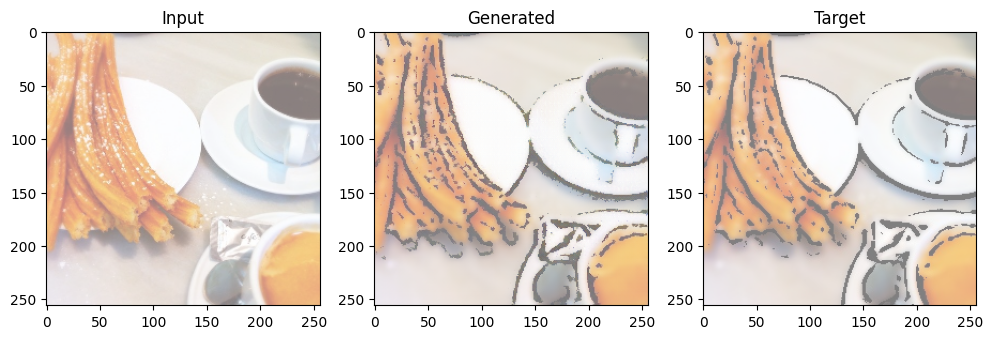

Epoch 46/50
Step 100: Generator Loss: 3.2568, Discriminator Loss: 1.1165
Step 200: Generator Loss: 3.5506, Discriminator Loss: 0.8799
Step 300: Generator Loss: 5.9404, Discriminator Loss: 0.5141
Step 400: Generator Loss: 4.4776, Discriminator Loss: 1.1101
Step 500: Generator Loss: 4.2658, Discriminator Loss: 0.9553
Step 600: Generator Loss: 3.2401, Discriminator Loss: 1.1035
Epoch 46 Completed: Avg Generator Loss: 3.8746, Avg Discriminator Loss: 0.9552


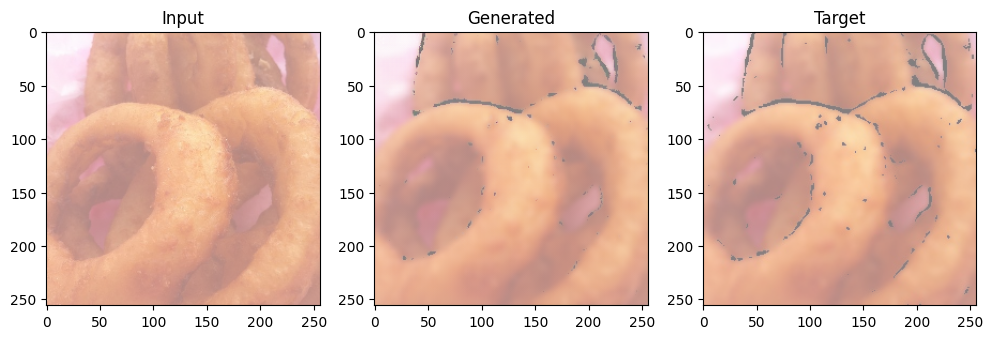

Epoch 47/50
Step 100: Generator Loss: 3.3361, Discriminator Loss: 1.3127
Step 200: Generator Loss: 4.3330, Discriminator Loss: 0.7597
Step 300: Generator Loss: 3.2378, Discriminator Loss: 1.0360
Step 400: Generator Loss: 3.6229, Discriminator Loss: 0.9316
Step 500: Generator Loss: 3.8975, Discriminator Loss: 0.8647
Step 600: Generator Loss: 4.2059, Discriminator Loss: 0.6498
Epoch 47 Completed: Avg Generator Loss: 3.9662, Avg Discriminator Loss: 1.0450


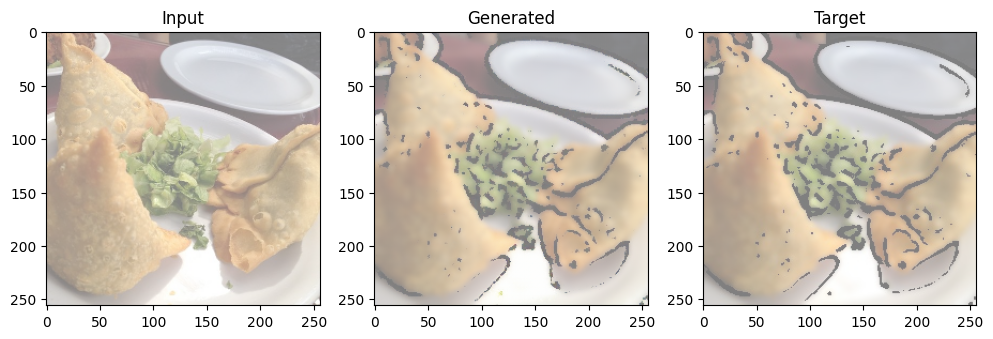

Epoch 48/50
Step 100: Generator Loss: 4.2882, Discriminator Loss: 0.8482
Step 200: Generator Loss: 3.7960, Discriminator Loss: 1.8616
Step 300: Generator Loss: 3.1466, Discriminator Loss: 1.3632
Step 400: Generator Loss: 3.5763, Discriminator Loss: 0.8600
Step 500: Generator Loss: 3.6797, Discriminator Loss: 0.7140
Step 600: Generator Loss: 2.3218, Discriminator Loss: 1.4852
Epoch 48 Completed: Avg Generator Loss: 3.9034, Avg Discriminator Loss: 0.9781


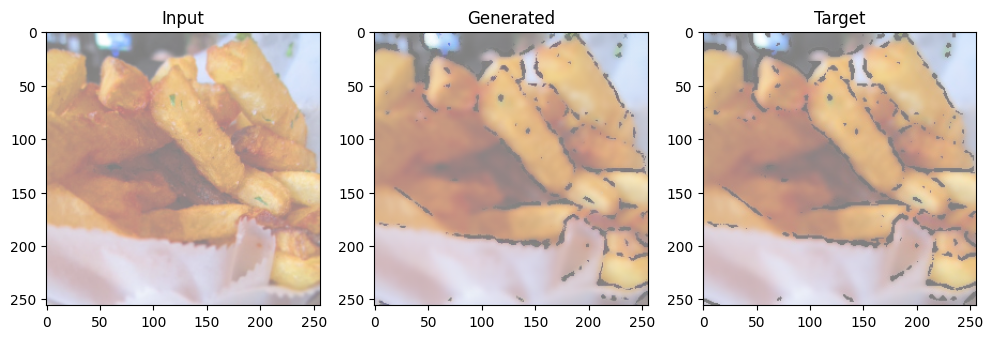

Epoch 49/50
Step 100: Generator Loss: 3.5932, Discriminator Loss: 1.0431
Step 200: Generator Loss: 3.3600, Discriminator Loss: 1.2892
Step 300: Generator Loss: 3.5491, Discriminator Loss: 0.7859
Step 400: Generator Loss: 3.0308, Discriminator Loss: 1.1306
Step 500: Generator Loss: 3.0129, Discriminator Loss: 1.0934
Step 600: Generator Loss: 3.8756, Discriminator Loss: 0.8048
Epoch 49 Completed: Avg Generator Loss: 3.9316, Avg Discriminator Loss: 0.9874


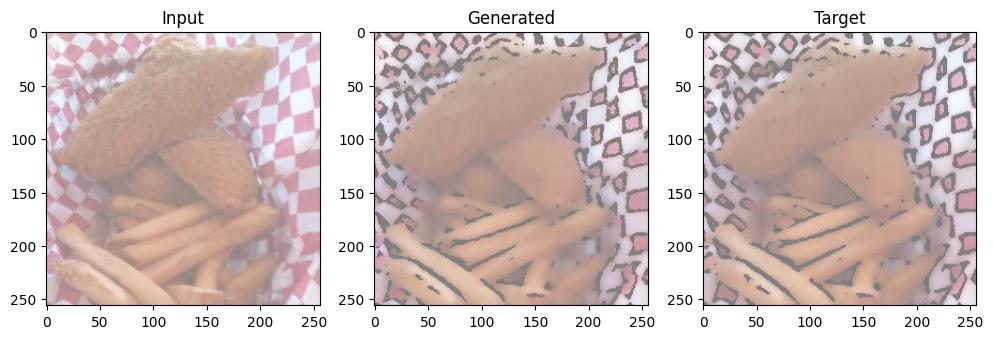

Epoch 50/50
Step 100: Generator Loss: 3.5661, Discriminator Loss: 0.8649
Step 200: Generator Loss: 4.1149, Discriminator Loss: 0.8971
Step 300: Generator Loss: 4.0883, Discriminator Loss: 1.8020
Step 400: Generator Loss: 3.1778, Discriminator Loss: 0.9799
Step 500: Generator Loss: 5.6327, Discriminator Loss: 0.6528
Step 600: Generator Loss: 6.1188, Discriminator Loss: 0.3479
Epoch 50 Completed: Avg Generator Loss: 3.8816, Avg Discriminator Loss: 0.9736


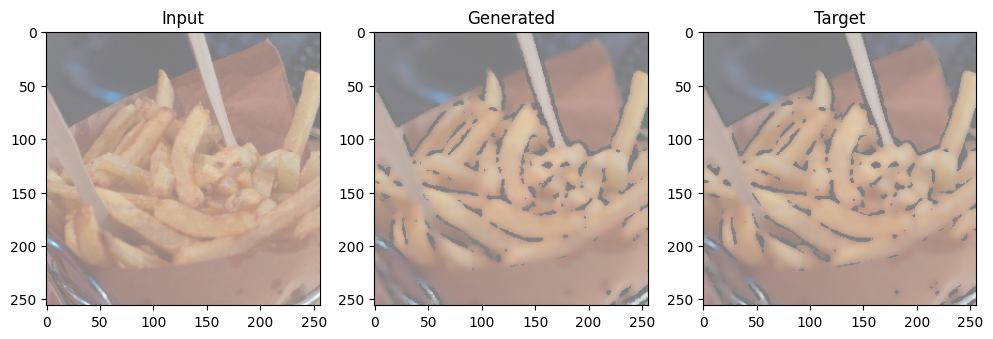

Model saved!


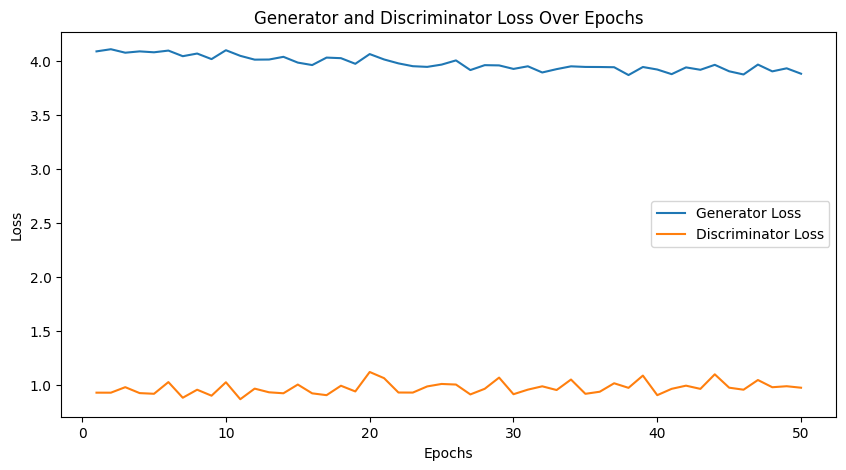

In [8]:
# ----------------------------- 
# Track Metrics 
# ----------------------------- 
# Create lists to store metrics per epoch 
gen_losses = [] 
disc_losses = [] 

# ----------------------------- 
# Train the GAN 
# ----------------------------- 
EPOCHS = 50 

for epoch in range(EPOCHS): 
    print(f"Epoch {epoch+1}/{EPOCHS}") 
    total_gen_loss = 0.0 
    total_disc_loss = 0.0 
    step = 0 
    
    for input_image, target_image in train_ds: 
        step += 1 
        # Perform training step 
        train_step(input_image, target_image) 
        
        # Compute losses 
        gen_output = generator(input_image, training=True) 
        disc_real_output = discriminator([input_image, target_image], training=True) 
        disc_fake_output = discriminator([input_image, gen_output], training=True) 

        gen_loss = generator_loss(disc_fake_output, gen_output, target_image) 
        disc_loss = discriminator_loss(disc_real_output, disc_fake_output) 
        
        total_gen_loss += gen_loss 
        total_disc_loss += disc_loss 
        
        if step % 100 == 0: 
            print(f"Step {step}: Generator Loss: {gen_loss.numpy():.4f}, Discriminator Loss: {disc_loss.numpy():.4f}") 
    
    # Average loss for the epoch 
    avg_gen_loss = total_gen_loss / len(train_ds) 
    avg_disc_loss = total_disc_loss / len(train_ds) 
    
    gen_losses.append(avg_gen_loss) 
    disc_losses.append(avg_disc_loss) 
    
    print(f"Epoch {epoch+1} Completed: Avg Generator Loss: {avg_gen_loss:.4f}, Avg Discriminator Loss: {avg_disc_loss:.4f}") 
    
    # Display results at the end of each epoch 
    generated_image = generator(input_image, training=False) 
    plt.figure(figsize=(12, 4)) 
    plt.subplot(1, 3, 1) 
    plt.title("Input") 
    plt.imshow(input_image[0] * 0.5 + 0.5) 
    plt.subplot(1, 3, 2) 
    plt.title("Generated") 
    plt.imshow(generated_image[0] * 0.5 + 0.5) 
    plt.subplot(1, 3, 3) 
    plt.title("Target") 
    plt.imshow(target_image[0] * 0.5 + 0.5) 
    plt.show() 

# ----------------------------- 
# Save the Generator 
# ----------------------------- 
generator.save("pix2pix_generator_model_with metrics.h5") 
print("Model saved!")

# -----------------------------
# Plot Generator and Discriminator Loss
# -----------------------------
plt.figure(figsize=(10, 5))
plt.plot(range(1, EPOCHS + 1), gen_losses, label="Generator Loss")
plt.plot(range(1, EPOCHS + 1), disc_losses, label="Discriminator Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.title("Generator and Discriminator Loss Over Epochs")
plt.show()

#### Loss Interpretation

The graph illustrates the **Generator Loss** and **Discriminator Loss** over **50 epochs** during the training of a GAN (Generative Adversarial Network).

---

##### 1. **Generator Loss (Blue Line)**
- The generator’s loss starts relatively high (around 4.0) and shows a slow decline over the epochs.
- **What this means:** 
  - The generator is learning to produce outputs that can increasingly fool the discriminator. 
  - A gradual decline is expected because the generator is improving over time.

---

##### 2. **Discriminator Loss (Orange Line)**
- The discriminator’s loss hovers around **1.0** and fluctuates slightly over time.
- **What this means:** 
  - The discriminator is maintaining a relatively stable ability to distinguish between real and fake data. 
  - The fluctuations indicate that the generator and discriminator are engaged in an adversarial battle.

---

##### 3. **GAN Stability**
- The losses for both the generator and discriminator are neither diverging significantly nor collapsing to zero. This suggests a relatively stable training process, which is a good sign for GAN training.

---

##### 4. **Points to Consider**
- **Balanced Training:** If the generator loss decreases too fast while the discriminator loss becomes very low, it could indicate that the discriminator is overpowering the generator, making training unstable.
- **Slight Fluctuations:** The small oscillations in the losses are typical for GANs as the two networks (generator and discriminator) are adversarially training against each other.

---

#### Summary:
The graph suggests that the GAN is training relatively stably. The generator is learning to create more realistic images (lower loss), while the discriminator is maintaining its effectiveness in distinguishing real from fake (constant loss).


#### Test on a picture

In [4]:
# -----------------------------
# Load the Saved Model
# -----------------------------
# Load the saved generator model
generator_model_path = "pix2pix_generator_model_with metrics.h5"  # Path to saved model
generator = tf.keras.models.load_model(generator_model_path)
print("Generator model loaded successfully!")



Generator model loaded successfully!


In [8]:
def evaluate_metrics(original, generated):
    """
    Calculate SSIM and PSNR using TensorFlow functions.
    """
    original = tf.squeeze(original)  # Remove batch dimension
    generated = tf.squeeze(generated)
    
    # Calculate SSIM and PSNR
    ssim_value = tf.image.ssim(original, generated, max_val=1.0)
    psnr_value = tf.image.psnr(original, generated, max_val=1.0)
    
    print(f"SSIM: {ssim_value.numpy():.4f}, PSNR: {psnr_value.numpy():.4f} dB")
    return original, generated

# Test the model on a new image
def preprocess_image(image_path, size=(256, 256)):
    img = tf.keras.preprocessing.image.load_img(image_path, target_size=size)
    img = tf.keras.preprocessing.image.img_to_array(img) / 255.0  # Normalize
    img = tf.expand_dims(img, axis=0)  # Add batch dimension
    return img



The script evaluates the quality of images generated by a GAN using two metrics: SSIM (Structural Similarity Index Measure) and PSNR (Peak Signal-to-Noise Ratio). SSIM measures how structurally similar the generated image is to the original, with values close to 1 indicating high similarity. PSNR quantifies the difference in pixel intensity between the images, with higher values indicating better quality. These metrics, combined with visual comparison, help assess the performance of the generator.

##### Test your image here

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.601289..0.98243606].


SSIM: 0.5970, PSNR: 15.4879 dB


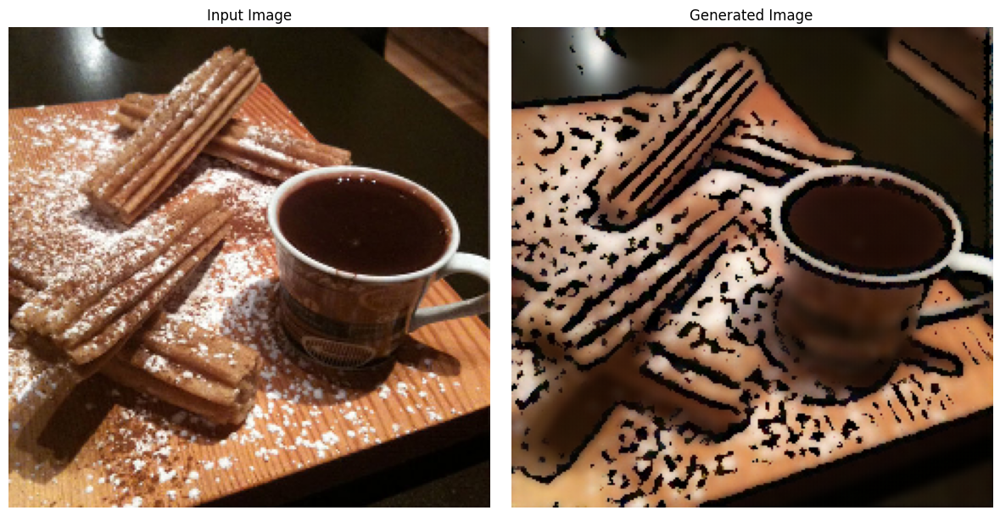

In [9]:
# Path to test image
test_image_path = r"food_dataset\fried_food_dataset\test\real_images\802.jpg"

# Preprocess and test the model
input_image = preprocess_image(test_image_path)
generated_image = generator(input_image, training=False)

# Evaluate metrics
original, generated = evaluate_metrics(input_image, generated_image)

# Visualize results
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title("Input Image")
plt.imshow(original.numpy())
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Generated Image")
plt.imshow(generated.numpy())
plt.axis("off")

plt.tight_layout()
plt.show()


The SSIM value of 0.5970 suggests that the generated image has moderate structural similarity to the original, but there is noticeable divergence in finer details or patterns. The PSNR value of 15.4879 dB indicates that the pixel differences between the original and generated images are substantial, reflecting a moderate level of noise or distortion in the output. While the GAN generates a reasonable approximation, there is room for improvement in capturing intricate details and minimizing pixel-level artifacts.

In [17]:
# Path to your image
your_image_path = r"image_to_test_model\homielanda.jpg"



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.28253436..0.98194903].


SSIM: 0.8100, PSNR: 22.0239 dB


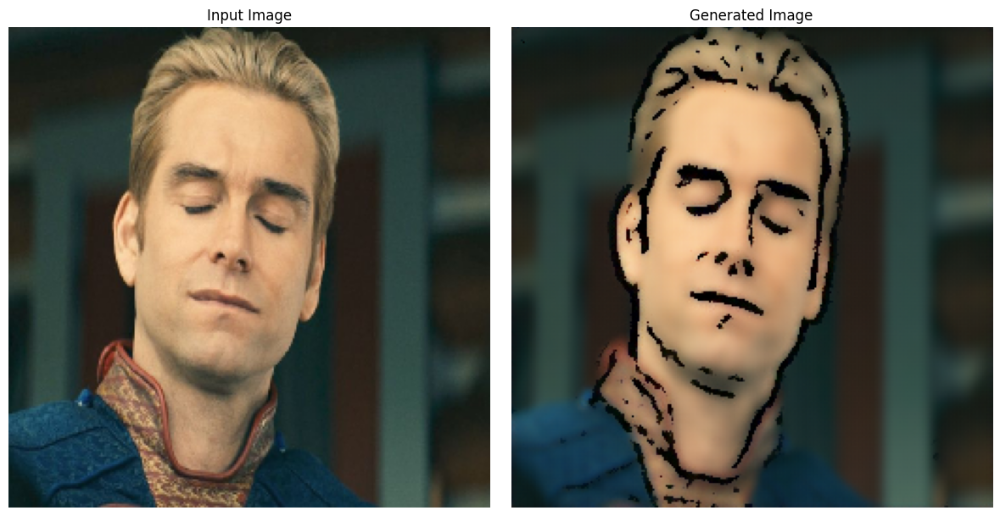

In [18]:
# Preprocess and test the model
input_image = preprocess_image(your_image_path)
generated_image = generator(input_image, training=False)

# Evaluate metrics
original, generated = evaluate_metrics(input_image, generated_image)

# Visualize results
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title("Input Image")
plt.imshow(original.numpy())
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Generated Image")
plt.imshow(generated.numpy())
plt.axis("off")

plt.tight_layout()
plt.show()

The SSIM value of 0.8100 indicates that the generated image has a high structural similarity to the original image. This means the model is effectively preserving the overall structure and content of the input image during the generation process.

The PSNR value of 22.0239 dB suggests a much lower level of pixel-level differences or noise compared to results with lower PSNR values. This implies that the generated image not only maintains structural integrity but also closely matches the pixel intensity values of the original image, resulting in a visually cleaner and more accurate output.